# 🤪 WGAN - CelebA Faces

In this notebook, we'll walk through the steps required to train your own Wasserstein GAN on the CelebA faces dataset

The code has been adapted from the excellent [WGAN-GP tutorial](https://keras.io/examples/generative/wgan_gp/) created by Aakash Kumar Nain, available on the Keras website.

In [1]:
%load_ext autoreload
%autoreload 2
import numpy as np

import tensorflow as tf
from tensorflow.keras import (
    layers,
    models,
    callbacks,
    utils,
    metrics,
    optimizers,
)

from notebooks.utils import display, sample_batch




2023-09-30 05:40:08.051236: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-09-30 05:40:08.521340: E tensorflow/stream_executor/cuda/cuda_blas.cc:2981] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


## 0. Parameters <a name="parameters"></a>

In [15]:
IMAGE_SIZE = 64
CHANNELS = 3
BATCH_SIZE = 512

NUM_FEATURES = 64
Z_DIM = 128
LEARNING_RATE = 0.0002
ADAM_BETA_1 = 0.5
ADAM_BETA_2 = 0.999
EPOCHS = 200
CRITIC_STEPS = 3
GP_WEIGHT = 10.0
LOAD_MODEL = False
ADAM_BETA_1 = 0.5
ADAM_BETA_2 = 0.9

## 1. Prepare the data <a name="prepare"></a>

In [3]:
# Load the data
train_data = utils.image_dataset_from_directory(
    "/app/data/pokemon sprite/Test",
    labels=None,
    color_mode="rgb",
    image_size=(IMAGE_SIZE, IMAGE_SIZE),
    batch_size=BATCH_SIZE,
    shuffle=True,
    seed=42,
    interpolation="bilinear",
)

train_data = train_data.repeat()

Found 92187 files belonging to 1 classes.


2023-09-30 05:51:38.978696: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:966] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2023-09-30 05:51:38.994337: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:966] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2023-09-30 05:51:38.994704: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:966] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2023-09-30 05:51:38.997731: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate

In [4]:
# Preprocess the data
def preprocess(img):
    """
    Normalize and reshape the images
    """
    img = (tf.cast(img, "float32") - 127.5) / 127.5
    return img


train = train_data.map(lambda x: preprocess(x))

In [5]:
# Show some faces from the training set
train_sample = sample_batch(train)

STEPS_PER_EPOCH = 100
print(STEPS_PER_EPOCH)

100


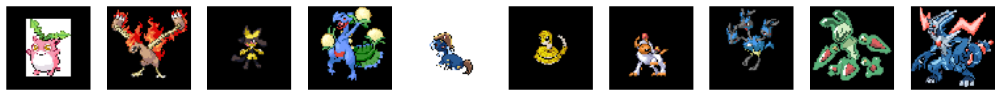

In [6]:
display(train_sample, cmap=None)

## 2. Build the WGAN-GP <a name="build"></a>

In [16]:
critic_input = layers.Input(shape=(IMAGE_SIZE, IMAGE_SIZE, CHANNELS))
x = layers.Conv2D(64, kernel_size=4, strides=2, padding="same")(critic_input)
x = layers.LeakyReLU(0.2)(x)
x = layers.Conv2D(128, kernel_size=4, strides=2, padding="same")(x)
x = layers.LeakyReLU()(x)
x = layers.Dropout(0.3)(x)
x = layers.Conv2D(256, kernel_size=4, strides=2, padding="same")(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Dropout(0.3)(x)
x = layers.Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Dropout(0.3)(x)
x = layers.Conv2D(1, kernel_size=4, strides=1, padding="valid")(x)
critic_output = layers.Flatten()(x)

critic = models.Model(critic_input, critic_output)
critic.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 64, 64, 3)]       0         
                                                                 
 conv2d_5 (Conv2D)           (None, 32, 32, 64)        3136      
                                                                 
 leaky_re_lu_8 (LeakyReLU)   (None, 32, 32, 64)        0         
                                                                 
 conv2d_6 (Conv2D)           (None, 16, 16, 128)       131200    
                                                                 
 leaky_re_lu_9 (LeakyReLU)   (None, 16, 16, 128)       0         
                                                                 
 dropout_3 (Dropout)         (None, 16, 16, 128)       0         
                                                                 
 conv2d_7 (Conv2D)           (None, 8, 8, 256)         5245

In [17]:
generator_input = layers.Input(shape=(Z_DIM,))
x = layers.Reshape((1, 1, Z_DIM))(generator_input)
x = layers.Conv2DTranspose(
    512, kernel_size=4, strides=1, padding="valid", use_bias=False
)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Conv2DTranspose(
    256, kernel_size=4, strides=2, padding="same", use_bias=False
)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Conv2DTranspose(
    128, kernel_size=4, strides=2, padding="same", use_bias=False
)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
x = layers.Conv2DTranspose(
    64, kernel_size=4, strides=2, padding="same", use_bias=False
)(x)
x = layers.BatchNormalization(momentum=0.9)(x)
x = layers.LeakyReLU(0.2)(x)
generator_output = layers.Conv2DTranspose(
    CHANNELS, kernel_size=4, strides=2, padding="same", activation="tanh"
)(x)
generator = models.Model(generator_input, generator_output)
generator.summary()

Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 128)]             0         
                                                                 
 reshape_1 (Reshape)         (None, 1, 1, 128)         0         
                                                                 
 conv2d_transpose_5 (Conv2DT  (None, 4, 4, 512)        1048576   
 ranspose)                                                       
                                                                 
 batch_normalization_4 (Batc  (None, 4, 4, 512)        2048      
 hNormalization)                                                 
                                                                 
 leaky_re_lu_12 (LeakyReLU)  (None, 4, 4, 512)         0         
                                                                 
 conv2d_transpose_6 (Conv2DT  (None, 8, 8, 256)        2097

In [18]:
class WGANGP(models.Model):
    def __init__(self, critic, generator, latent_dim, critic_steps, gp_weight):
        super(WGANGP, self).__init__()
        self.critic = critic
        self.generator = generator
        self.latent_dim = latent_dim
        self.critic_steps = critic_steps
        self.gp_weight = gp_weight

    def compile(self, c_optimizer, g_optimizer):
        super(WGANGP, self).compile()
        self.c_optimizer = c_optimizer
        self.g_optimizer = g_optimizer
        self.c_wass_loss_metric = metrics.Mean(name="c_wass_loss")
        self.c_gp_metric = metrics.Mean(name="c_gp")
        self.c_loss_metric = metrics.Mean(name="c_loss")
        self.g_loss_metric = metrics.Mean(name="g_loss")

    @property
    def metrics(self):
        return [
            self.c_loss_metric,
            self.c_wass_loss_metric,
            self.c_gp_metric,
            self.g_loss_metric,
        ]

    def gradient_penalty(self, batch_size, real_images, fake_images):
        alpha = tf.random.normal([batch_size, 1, 1, 1], 0.0, 1.0)
        diff = fake_images - real_images
        interpolated = real_images + alpha * diff

        with tf.GradientTape() as gp_tape:
            gp_tape.watch(interpolated)
            pred = self.critic(interpolated, training=True)

        grads = gp_tape.gradient(pred, [interpolated])[0]
        norm = tf.sqrt(tf.reduce_sum(tf.square(grads), axis=[1, 2, 3]))
        gp = tf.reduce_mean((norm - 1.0) ** 2)
        return gp

    def train_step(self, real_images):
        batch_size = tf.shape(real_images)[0]

        for i in range(self.critic_steps):
            random_latent_vectors = tf.random.normal(
                shape=(batch_size, self.latent_dim)
            )

            with tf.GradientTape() as tape:
                fake_images = self.generator(
                    random_latent_vectors, training=True
                )
                fake_predictions = self.critic(fake_images, training=True)
                real_predictions = self.critic(real_images, training=True)

                c_wass_loss = tf.reduce_mean(fake_predictions) - tf.reduce_mean(
                    real_predictions
                )
                c_gp = self.gradient_penalty(
                    batch_size, real_images, fake_images
                )
                c_loss = c_wass_loss + c_gp * self.gp_weight

            c_gradient = tape.gradient(c_loss, self.critic.trainable_variables)
            self.c_optimizer.apply_gradients(
                zip(c_gradient, self.critic.trainable_variables)
            )

        random_latent_vectors = tf.random.normal(
            shape=(batch_size, self.latent_dim)
        )
        with tf.GradientTape() as tape:
            fake_images = self.generator(random_latent_vectors, training=True)
            fake_predictions = self.critic(fake_images, training=True)
            g_loss = -tf.reduce_mean(fake_predictions)

        gen_gradient = tape.gradient(g_loss, self.generator.trainable_variables)
        self.g_optimizer.apply_gradients(
            zip(gen_gradient, self.generator.trainable_variables)
        )

        self.c_loss_metric.update_state(c_loss)
        self.c_wass_loss_metric.update_state(c_wass_loss)
        self.c_gp_metric.update_state(c_gp)
        self.g_loss_metric.update_state(g_loss)

        return {m.name: m.result() for m in self.metrics}

In [19]:
# Create a GAN
wgangp = WGANGP(
    critic=critic,
    generator=generator,
    latent_dim=Z_DIM,
    critic_steps=CRITIC_STEPS,
    gp_weight=GP_WEIGHT,
)

In [20]:
if LOAD_MODEL:
    wgangp.load_weights("./checkpoint/checkpoint.ckpt")

## 3. Train the GAN <a name="train"></a>

In [21]:
# Compile the GAN
wgangp.compile(
    c_optimizer=optimizers.Adam(
        learning_rate=LEARNING_RATE, beta_1=ADAM_BETA_1, beta_2=ADAM_BETA_2
    ),
    g_optimizer=optimizers.Adam(
        learning_rate=LEARNING_RATE, beta_1=ADAM_BETA_1, beta_2=ADAM_BETA_2
    ),
)

In [22]:
# Create a model save checkpoint
model_checkpoint_callback = callbacks.ModelCheckpoint(
    filepath="./checkpoint/checkpoint.ckpt",
    save_weights_only=True,
    save_freq="epoch",
    verbose=0,
)

tensorboard_callback = callbacks.TensorBoard(log_dir="./logs")


class ImageGenerator(callbacks.Callback):
    def __init__(self, num_img, latent_dim):
        self.num_img = num_img
        self.latent_dim = latent_dim

    def on_epoch_end(self, epoch, logs=None):
        random_latent_vectors = tf.random.normal(
            shape=(self.num_img, self.latent_dim)
        )
        generated_images = self.model.generator(random_latent_vectors)
        generated_images = generated_images * 127.5 + 127.5
        generated_images = generated_images.numpy()
        display(
            generated_images,
            save_to="./output/generated_img_%03d.png" % (epoch),
            cmap=None,
        )

Epoch 1/200
100/100 [==============================] - ETA: 0s - c_loss: -96.2549 - c_wass_loss: -150.2872 - c_gp: 5.4032 - g_loss: -76.1969
Saved to ./output/generated_img_000.png


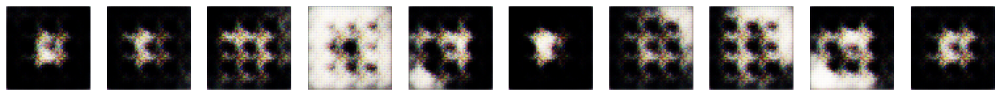

100/100 [==============================] - 95s 855ms/step - c_loss: -96.2549 - c_wass_loss: -150.2872 - c_gp: 5.4032 - g_loss: -76.1969
Epoch 2/200
100/100 [==============================] - ETA: 0s - c_loss: -31.8766 - c_wass_loss: -42.5186 - c_gp: 1.0642 - g_loss: -78.3041
Saved to ./output/generated_img_001.png


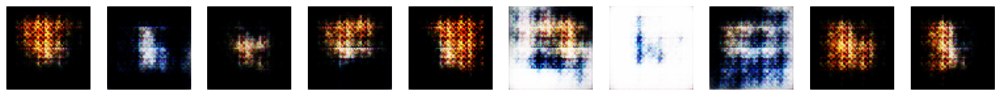

100/100 [==============================] - 86s 861ms/step - c_loss: -31.8766 - c_wass_loss: -42.5186 - c_gp: 1.0642 - g_loss: -78.3041
Epoch 3/200
100/100 [==============================] - ETA: 0s - c_loss: -20.7390 - c_wass_loss: -25.9792 - c_gp: 0.5240 - g_loss: -73.3485
Saved to ./output/generated_img_002.png


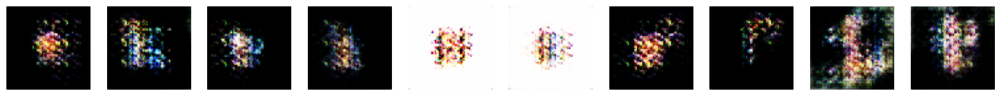

100/100 [==============================] - 87s 867ms/step - c_loss: -20.7390 - c_wass_loss: -25.9792 - c_gp: 0.5240 - g_loss: -73.3485
Epoch 4/200
100/100 [==============================] - ETA: 0s - c_loss: -17.4681 - c_wass_loss: -21.5242 - c_gp: 0.4056 - g_loss: -76.4441
Saved to ./output/generated_img_003.png


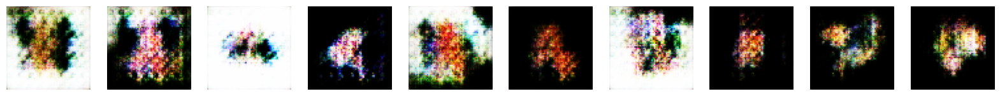

100/100 [==============================] - 86s 858ms/step - c_loss: -17.4681 - c_wass_loss: -21.5242 - c_gp: 0.4056 - g_loss: -76.4441
Epoch 5/200
100/100 [==============================] - ETA: 0s - c_loss: -14.0045 - c_wass_loss: -16.8256 - c_gp: 0.2821 - g_loss: -71.4611
Saved to ./output/generated_img_004.png


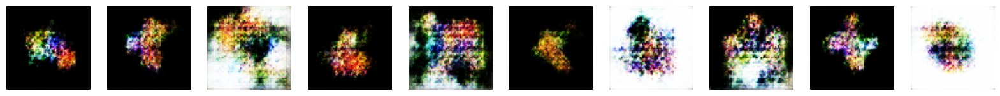

100/100 [==============================] - 87s 872ms/step - c_loss: -14.0045 - c_wass_loss: -16.8256 - c_gp: 0.2821 - g_loss: -71.4611
Epoch 6/200
100/100 [==============================] - ETA: 0s - c_loss: -12.9541 - c_wass_loss: -15.3037 - c_gp: 0.2350 - g_loss: -66.3848
Saved to ./output/generated_img_005.png


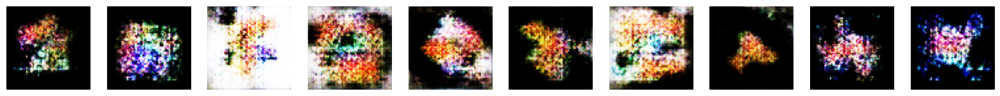

100/100 [==============================] - 86s 858ms/step - c_loss: -12.9541 - c_wass_loss: -15.3037 - c_gp: 0.2350 - g_loss: -66.3848
Epoch 7/200
100/100 [==============================] - ETA: 0s - c_loss: -11.9368 - c_wass_loss: -14.0807 - c_gp: 0.2144 - g_loss: -73.7916
Saved to ./output/generated_img_006.png


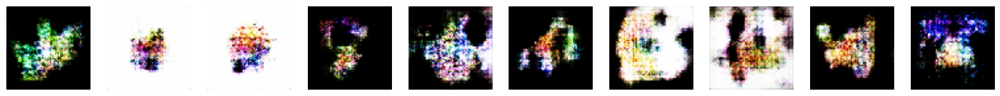

100/100 [==============================] - 87s 868ms/step - c_loss: -11.9368 - c_wass_loss: -14.0807 - c_gp: 0.2144 - g_loss: -73.7916
Epoch 8/200
100/100 [==============================] - ETA: 0s - c_loss: -10.6396 - c_wass_loss: -12.3905 - c_gp: 0.1751 - g_loss: -62.1421
Saved to ./output/generated_img_007.png


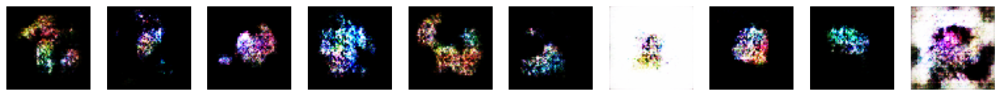

100/100 [==============================] - 86s 863ms/step - c_loss: -10.6396 - c_wass_loss: -12.3905 - c_gp: 0.1751 - g_loss: -62.1421
Epoch 9/200
100/100 [==============================] - ETA: 0s - c_loss: -10.0062 - c_wass_loss: -11.6180 - c_gp: 0.1612 - g_loss: -70.7358
Saved to ./output/generated_img_008.png


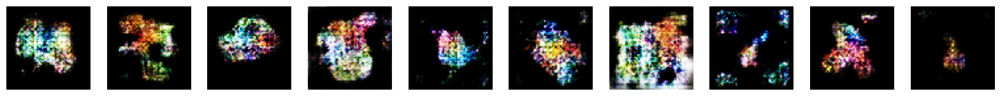

100/100 [==============================] - 86s 864ms/step - c_loss: -10.0062 - c_wass_loss: -11.6180 - c_gp: 0.1612 - g_loss: -70.7358
Epoch 10/200
100/100 [==============================] - ETA: 0s - c_loss: -8.5191 - c_wass_loss: -9.7770 - c_gp: 0.1258 - g_loss: -54.6049
Saved to ./output/generated_img_009.png


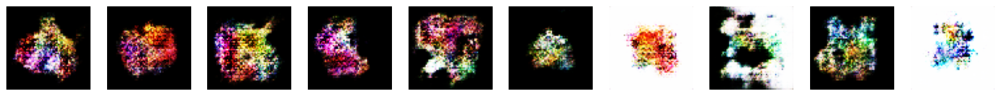

100/100 [==============================] - 86s 857ms/step - c_loss: -8.5191 - c_wass_loss: -9.7770 - c_gp: 0.1258 - g_loss: -54.6049
Epoch 11/200
100/100 [==============================] - ETA: 0s - c_loss: -8.1930 - c_wass_loss: -9.3786 - c_gp: 0.1186 - g_loss: -44.7164
Saved to ./output/generated_img_010.png


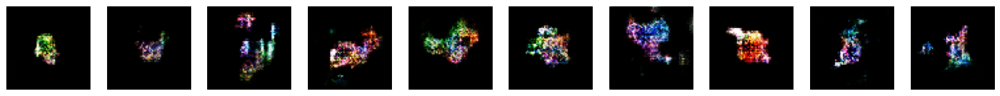

100/100 [==============================] - 86s 859ms/step - c_loss: -8.1930 - c_wass_loss: -9.3786 - c_gp: 0.1186 - g_loss: -44.7164
Epoch 12/200
100/100 [==============================] - ETA: 0s - c_loss: -7.8620 - c_wass_loss: -9.0502 - c_gp: 0.1188 - g_loss: -42.0507
Saved to ./output/generated_img_011.png


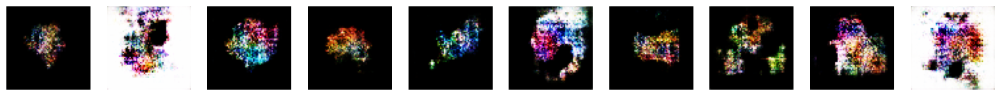

100/100 [==============================] - 86s 864ms/step - c_loss: -7.8620 - c_wass_loss: -9.0502 - c_gp: 0.1188 - g_loss: -42.0507
Epoch 13/200
100/100 [==============================] - ETA: 0s - c_loss: -7.1979 - c_wass_loss: -8.2530 - c_gp: 0.1055 - g_loss: -33.4704
Saved to ./output/generated_img_012.png


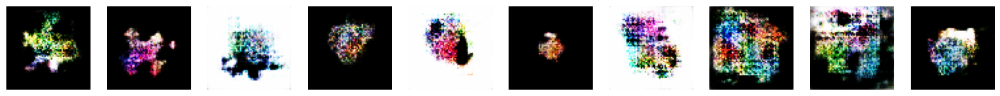

100/100 [==============================] - 86s 856ms/step - c_loss: -7.1979 - c_wass_loss: -8.2530 - c_gp: 0.1055 - g_loss: -33.4704
Epoch 14/200
100/100 [==============================] - ETA: 0s - c_loss: -6.9116 - c_wass_loss: -7.8606 - c_gp: 0.0949 - g_loss: -32.3475
Saved to ./output/generated_img_013.png


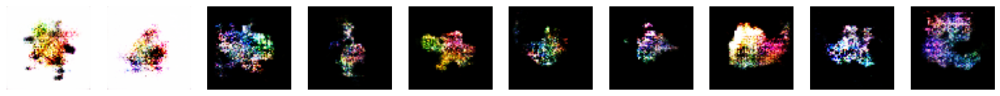

100/100 [==============================] - 86s 864ms/step - c_loss: -6.9116 - c_wass_loss: -7.8606 - c_gp: 0.0949 - g_loss: -32.3475
Epoch 15/200
100/100 [==============================] - ETA: 0s - c_loss: -6.6346 - c_wass_loss: -7.5898 - c_gp: 0.0955 - g_loss: -35.3481
Saved to ./output/generated_img_014.png


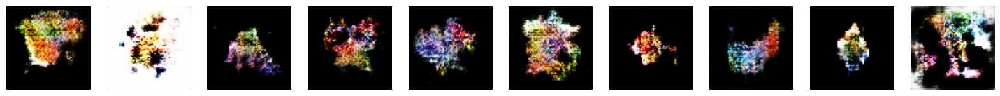

100/100 [==============================] - 86s 857ms/step - c_loss: -6.6346 - c_wass_loss: -7.5898 - c_gp: 0.0955 - g_loss: -35.3481
Epoch 16/200
100/100 [==============================] - ETA: 0s - c_loss: -6.3725 - c_wass_loss: -7.2595 - c_gp: 0.0887 - g_loss: -41.5056
Saved to ./output/generated_img_015.png


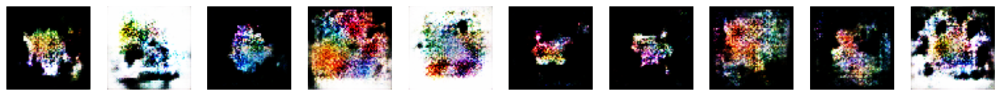

100/100 [==============================] - 87s 868ms/step - c_loss: -6.3725 - c_wass_loss: -7.2595 - c_gp: 0.0887 - g_loss: -41.5056
Epoch 17/200
100/100 [==============================] - ETA: 0s - c_loss: -6.3919 - c_wass_loss: -7.2759 - c_gp: 0.0884 - g_loss: -36.2651
Saved to ./output/generated_img_016.png


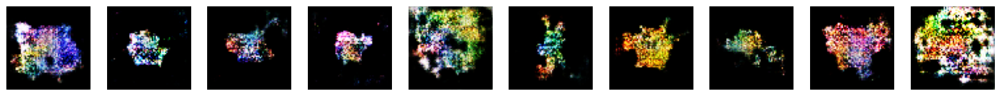

100/100 [==============================] - 86s 863ms/step - c_loss: -6.3919 - c_wass_loss: -7.2759 - c_gp: 0.0884 - g_loss: -36.2651
Epoch 18/200
100/100 [==============================] - ETA: 0s - c_loss: -6.3175 - c_wass_loss: -7.2394 - c_gp: 0.0922 - g_loss: -33.8864
Saved to ./output/generated_img_017.png


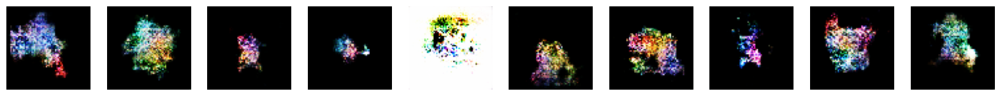

100/100 [==============================] - 87s 875ms/step - c_loss: -6.3175 - c_wass_loss: -7.2394 - c_gp: 0.0922 - g_loss: -33.8864
Epoch 19/200
100/100 [==============================] - ETA: 0s - c_loss: -6.2888 - c_wass_loss: -7.1488 - c_gp: 0.0860 - g_loss: -39.2584
Saved to ./output/generated_img_018.png


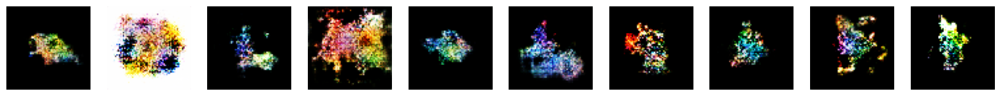

100/100 [==============================] - 86s 856ms/step - c_loss: -6.2888 - c_wass_loss: -7.1488 - c_gp: 0.0860 - g_loss: -39.2584
Epoch 20/200
100/100 [==============================] - ETA: 0s - c_loss: -6.3168 - c_wass_loss: -7.3059 - c_gp: 0.0989 - g_loss: -25.7911
Saved to ./output/generated_img_019.png


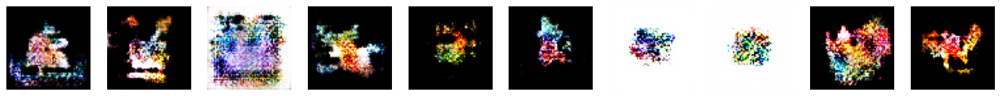

100/100 [==============================] - 85s 854ms/step - c_loss: -6.3168 - c_wass_loss: -7.3059 - c_gp: 0.0989 - g_loss: -25.7911
Epoch 21/200
100/100 [==============================] - ETA: 0s - c_loss: -6.2747 - c_wass_loss: -7.1498 - c_gp: 0.0875 - g_loss: -34.4492
Saved to ./output/generated_img_020.png


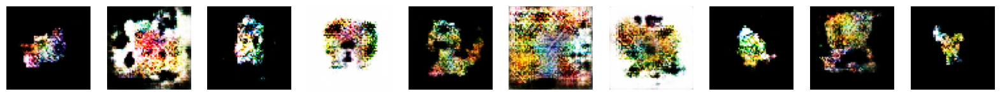

100/100 [==============================] - 86s 862ms/step - c_loss: -6.2747 - c_wass_loss: -7.1498 - c_gp: 0.0875 - g_loss: -34.4492
Epoch 22/200
100/100 [==============================] - ETA: 0s - c_loss: -6.2302 - c_wass_loss: -7.1756 - c_gp: 0.0945 - g_loss: -35.7154
Saved to ./output/generated_img_021.png


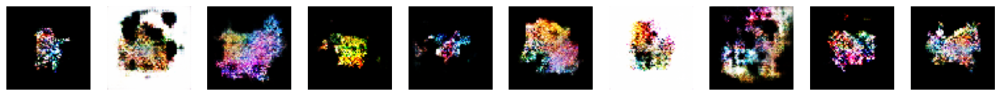

100/100 [==============================] - 85s 855ms/step - c_loss: -6.2302 - c_wass_loss: -7.1756 - c_gp: 0.0945 - g_loss: -35.7154
Epoch 23/200
100/100 [==============================] - ETA: 0s - c_loss: -6.2066 - c_wass_loss: -7.1653 - c_gp: 0.0959 - g_loss: -48.2628
Saved to ./output/generated_img_022.png


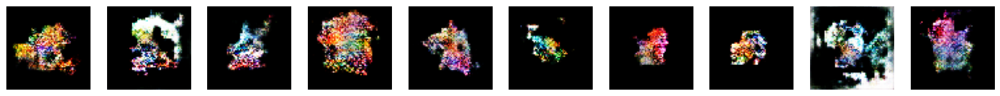

100/100 [==============================] - 86s 863ms/step - c_loss: -6.2066 - c_wass_loss: -7.1653 - c_gp: 0.0959 - g_loss: -48.2628
Epoch 24/200
100/100 [==============================] - ETA: 0s - c_loss: -5.9085 - c_wass_loss: -6.8012 - c_gp: 0.0893 - g_loss: -44.4849
Saved to ./output/generated_img_023.png


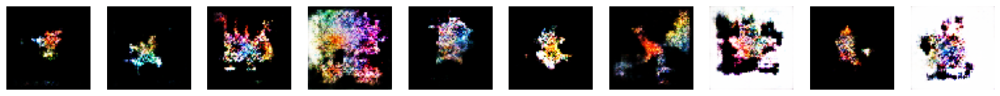

100/100 [==============================] - 86s 860ms/step - c_loss: -5.9085 - c_wass_loss: -6.8012 - c_gp: 0.0893 - g_loss: -44.4849
Epoch 25/200
100/100 [==============================] - ETA: 0s - c_loss: -5.7855 - c_wass_loss: -6.6659 - c_gp: 0.0880 - g_loss: -42.3499
Saved to ./output/generated_img_024.png


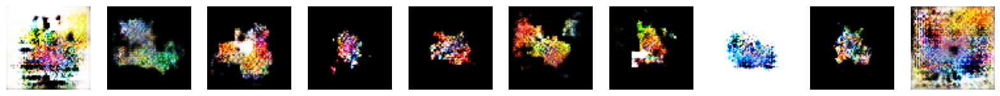

100/100 [==============================] - 86s 862ms/step - c_loss: -5.7855 - c_wass_loss: -6.6659 - c_gp: 0.0880 - g_loss: -42.3499
Epoch 26/200
100/100 [==============================] - ETA: 0s - c_loss: -5.6465 - c_wass_loss: -6.5601 - c_gp: 0.0914 - g_loss: -50.4537
Saved to ./output/generated_img_025.png


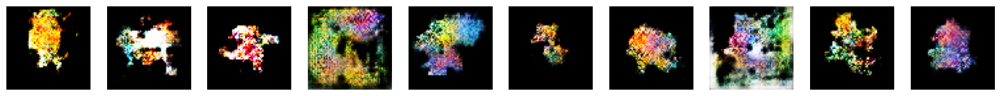

100/100 [==============================] - 86s 855ms/step - c_loss: -5.6465 - c_wass_loss: -6.5601 - c_gp: 0.0914 - g_loss: -50.4537
Epoch 27/200
100/100 [==============================] - ETA: 0s - c_loss: -6.1207 - c_wass_loss: -7.0406 - c_gp: 0.0920 - g_loss: -46.9401
Saved to ./output/generated_img_026.png


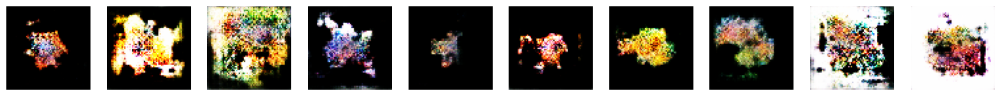

100/100 [==============================] - 87s 873ms/step - c_loss: -6.1207 - c_wass_loss: -7.0406 - c_gp: 0.0920 - g_loss: -46.9401
Epoch 28/200
100/100 [==============================] - ETA: 0s - c_loss: -6.3921 - c_wass_loss: -7.3199 - c_gp: 0.0928 - g_loss: -41.9723
Saved to ./output/generated_img_027.png


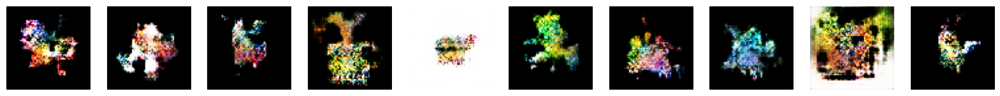

100/100 [==============================] - 86s 855ms/step - c_loss: -6.3921 - c_wass_loss: -7.3199 - c_gp: 0.0928 - g_loss: -41.9723
Epoch 29/200
100/100 [==============================] - ETA: 0s - c_loss: -6.4209 - c_wass_loss: -7.4475 - c_gp: 0.1027 - g_loss: -37.5306
Saved to ./output/generated_img_028.png


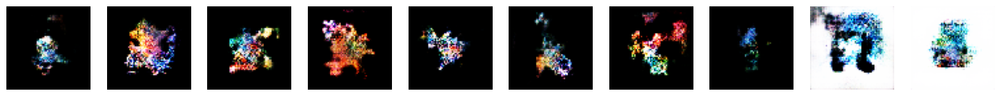

100/100 [==============================] - 86s 856ms/step - c_loss: -6.4209 - c_wass_loss: -7.4475 - c_gp: 0.1027 - g_loss: -37.5306
Epoch 30/200
100/100 [==============================] - ETA: 0s - c_loss: -6.3252 - c_wass_loss: -7.3214 - c_gp: 0.0996 - g_loss: -43.8702
Saved to ./output/generated_img_029.png


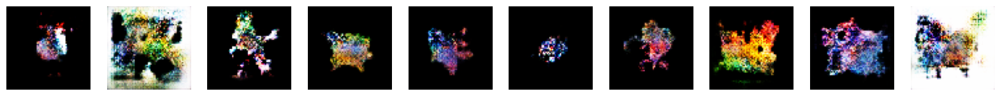

100/100 [==============================] - 87s 868ms/step - c_loss: -6.3252 - c_wass_loss: -7.3214 - c_gp: 0.0996 - g_loss: -43.8702
Epoch 31/200
100/100 [==============================] - ETA: 0s - c_loss: -6.7519 - c_wass_loss: -7.7817 - c_gp: 0.1030 - g_loss: -57.5458
Saved to ./output/generated_img_030.png


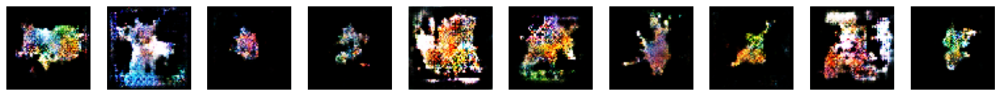

100/100 [==============================] - 86s 858ms/step - c_loss: -6.7519 - c_wass_loss: -7.7817 - c_gp: 0.1030 - g_loss: -57.5458
Epoch 32/200
100/100 [==============================] - ETA: 0s - c_loss: -6.7858 - c_wass_loss: -7.8997 - c_gp: 0.1114 - g_loss: -42.3878
Saved to ./output/generated_img_031.png


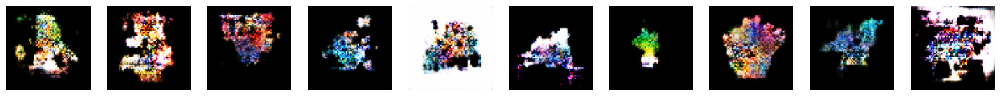

100/100 [==============================] - 86s 863ms/step - c_loss: -6.7858 - c_wass_loss: -7.8997 - c_gp: 0.1114 - g_loss: -42.3878
Epoch 33/200
100/100 [==============================] - ETA: 0s - c_loss: -6.7178 - c_wass_loss: -7.7226 - c_gp: 0.1005 - g_loss: -44.4041
Saved to ./output/generated_img_032.png


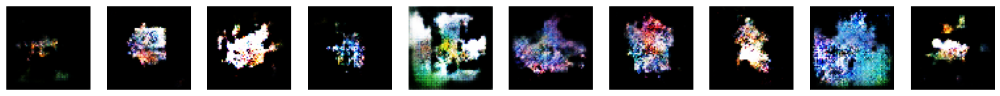

100/100 [==============================] - 86s 856ms/step - c_loss: -6.7178 - c_wass_loss: -7.7226 - c_gp: 0.1005 - g_loss: -44.4041
Epoch 34/200
100/100 [==============================] - ETA: 0s - c_loss: -6.5829 - c_wass_loss: -7.6510 - c_gp: 0.1068 - g_loss: -40.6614
Saved to ./output/generated_img_033.png


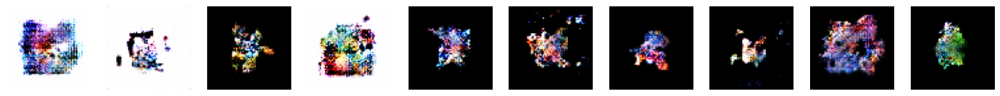

100/100 [==============================] - 86s 863ms/step - c_loss: -6.5829 - c_wass_loss: -7.6510 - c_gp: 0.1068 - g_loss: -40.6614
Epoch 35/200
100/100 [==============================] - ETA: 0s - c_loss: -6.8415 - c_wass_loss: -7.9018 - c_gp: 0.1060 - g_loss: -30.0685
Saved to ./output/generated_img_034.png


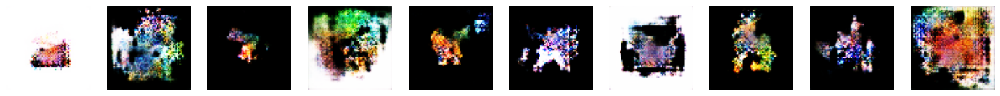

100/100 [==============================] - 86s 856ms/step - c_loss: -6.8415 - c_wass_loss: -7.9018 - c_gp: 0.1060 - g_loss: -30.0685
Epoch 36/200
100/100 [==============================] - ETA: 0s - c_loss: -6.7323 - c_wass_loss: -7.8376 - c_gp: 0.1105 - g_loss: -38.7748
Saved to ./output/generated_img_035.png


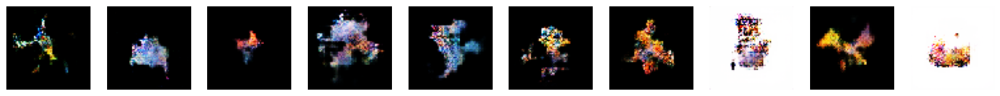

100/100 [==============================] - 86s 863ms/step - c_loss: -6.7323 - c_wass_loss: -7.8376 - c_gp: 0.1105 - g_loss: -38.7748
Epoch 37/200
100/100 [==============================] - ETA: 0s - c_loss: -7.0101 - c_wass_loss: -8.0645 - c_gp: 0.1054 - g_loss: -36.1557
Saved to ./output/generated_img_036.png


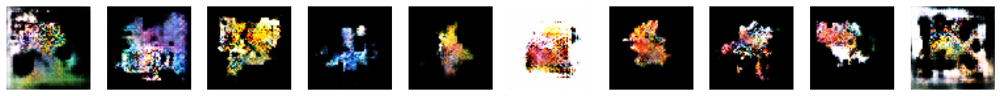

100/100 [==============================] - 86s 860ms/step - c_loss: -7.0101 - c_wass_loss: -8.0645 - c_gp: 0.1054 - g_loss: -36.1557
Epoch 38/200
100/100 [==============================] - ETA: 0s - c_loss: -7.0517 - c_wass_loss: -8.1450 - c_gp: 0.1093 - g_loss: -26.4853
Saved to ./output/generated_img_037.png


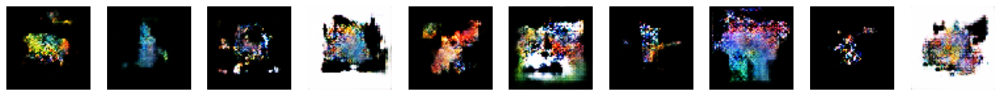

100/100 [==============================] - 86s 863ms/step - c_loss: -7.0517 - c_wass_loss: -8.1450 - c_gp: 0.1093 - g_loss: -26.4853
Epoch 39/200
100/100 [==============================] - ETA: 0s - c_loss: -6.8586 - c_wass_loss: -7.9232 - c_gp: 0.1065 - g_loss: -25.7986
Saved to ./output/generated_img_038.png


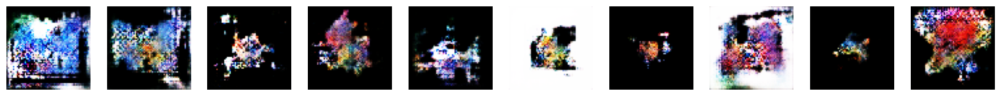

100/100 [==============================] - 86s 865ms/step - c_loss: -6.8586 - c_wass_loss: -7.9232 - c_gp: 0.1065 - g_loss: -25.7986
Epoch 40/200
100/100 [==============================] - ETA: 0s - c_loss: -6.9922 - c_wass_loss: -8.1277 - c_gp: 0.1136 - g_loss: -24.6470
Saved to ./output/generated_img_039.png


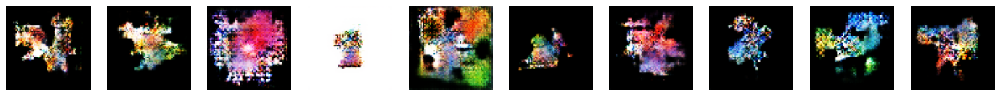

100/100 [==============================] - 86s 857ms/step - c_loss: -6.9922 - c_wass_loss: -8.1277 - c_gp: 0.1136 - g_loss: -24.6470
Epoch 41/200
100/100 [==============================] - ETA: 0s - c_loss: -6.7045 - c_wass_loss: -7.7891 - c_gp: 0.1085 - g_loss: -5.2526
Saved to ./output/generated_img_040.png


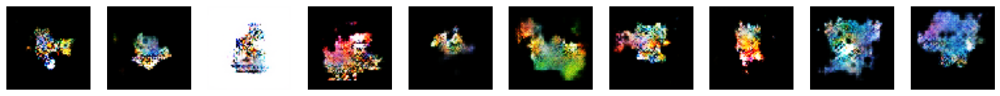

100/100 [==============================] - 86s 864ms/step - c_loss: -6.7045 - c_wass_loss: -7.7891 - c_gp: 0.1085 - g_loss: -5.2526
Epoch 42/200
100/100 [==============================] - ETA: 0s - c_loss: -6.7990 - c_wass_loss: -7.9160 - c_gp: 0.1117 - g_loss: -15.6076
Saved to ./output/generated_img_041.png


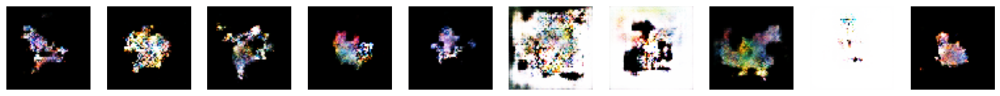

100/100 [==============================] - 86s 861ms/step - c_loss: -6.7990 - c_wass_loss: -7.9160 - c_gp: 0.1117 - g_loss: -15.6076
Epoch 43/200
100/100 [==============================] - ETA: 0s - c_loss: -6.6209 - c_wass_loss: -7.6835 - c_gp: 0.1063 - g_loss: -10.9043
Saved to ./output/generated_img_042.png


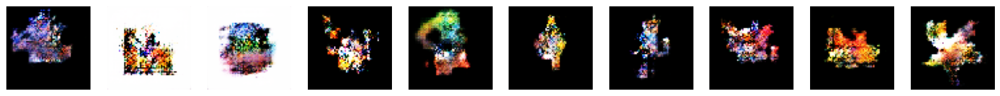

100/100 [==============================] - 87s 868ms/step - c_loss: -6.6209 - c_wass_loss: -7.6835 - c_gp: 0.1063 - g_loss: -10.9043
Epoch 44/200
100/100 [==============================] - ETA: 0s - c_loss: -6.9229 - c_wass_loss: -8.0220 - c_gp: 0.1099 - g_loss: -6.3704
Saved to ./output/generated_img_043.png


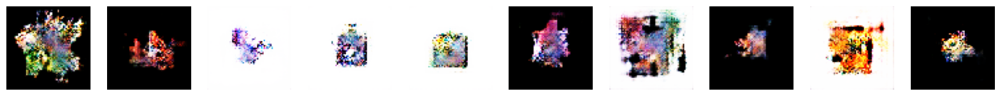

100/100 [==============================] - 86s 864ms/step - c_loss: -6.9229 - c_wass_loss: -8.0220 - c_gp: 0.1099 - g_loss: -6.3704
Epoch 45/200
100/100 [==============================] - ETA: 0s - c_loss: -6.9154 - c_wass_loss: -7.9630 - c_gp: 0.1048 - g_loss: -19.4028
Saved to ./output/generated_img_044.png


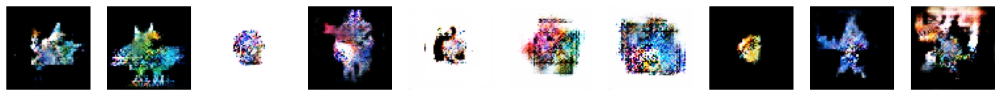

100/100 [==============================] - 86s 864ms/step - c_loss: -6.9154 - c_wass_loss: -7.9630 - c_gp: 0.1048 - g_loss: -19.4028
Epoch 46/200
100/100 [==============================] - ETA: 0s - c_loss: -6.4412 - c_wass_loss: -7.5064 - c_gp: 0.1065 - g_loss: -24.1644
Saved to ./output/generated_img_045.png


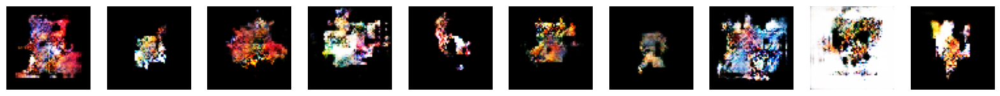

100/100 [==============================] - 86s 856ms/step - c_loss: -6.4412 - c_wass_loss: -7.5064 - c_gp: 0.1065 - g_loss: -24.1644
Epoch 47/200
100/100 [==============================] - ETA: 0s - c_loss: -6.7615 - c_wass_loss: -7.8445 - c_gp: 0.1083 - g_loss: -11.5651
Saved to ./output/generated_img_046.png


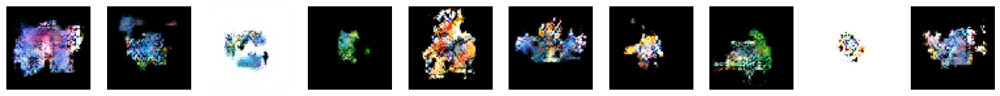

100/100 [==============================] - 87s 872ms/step - c_loss: -6.7615 - c_wass_loss: -7.8445 - c_gp: 0.1083 - g_loss: -11.5651
Epoch 48/200
100/100 [==============================] - ETA: 0s - c_loss: -6.5082 - c_wass_loss: -7.5415 - c_gp: 0.1033 - g_loss: -16.8734
Saved to ./output/generated_img_047.png


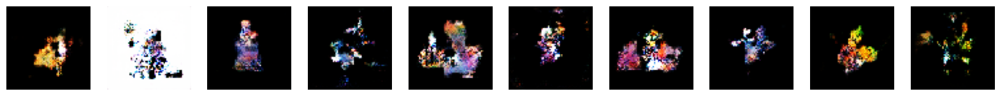

100/100 [==============================] - 87s 866ms/step - c_loss: -6.5082 - c_wass_loss: -7.5415 - c_gp: 0.1033 - g_loss: -16.8734
Epoch 49/200
100/100 [==============================] - ETA: 0s - c_loss: -6.6538 - c_wass_loss: -7.6817 - c_gp: 0.1028 - g_loss: -13.6687
Saved to ./output/generated_img_048.png


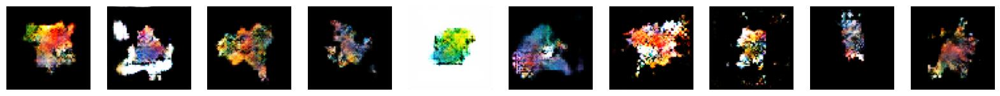

100/100 [==============================] - 86s 862ms/step - c_loss: -6.6538 - c_wass_loss: -7.6817 - c_gp: 0.1028 - g_loss: -13.6687
Epoch 50/200
100/100 [==============================] - ETA: 0s - c_loss: -6.6780 - c_wass_loss: -7.7543 - c_gp: 0.1076 - g_loss: -18.1154
Saved to ./output/generated_img_049.png


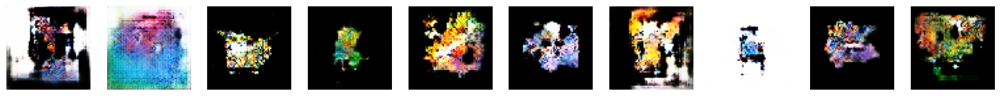

100/100 [==============================] - 87s 866ms/step - c_loss: -6.6780 - c_wass_loss: -7.7543 - c_gp: 0.1076 - g_loss: -18.1154
Epoch 51/200
100/100 [==============================] - ETA: 0s - c_loss: -6.6578 - c_wass_loss: -7.7329 - c_gp: 0.1075 - g_loss: -19.8310
Saved to ./output/generated_img_050.png


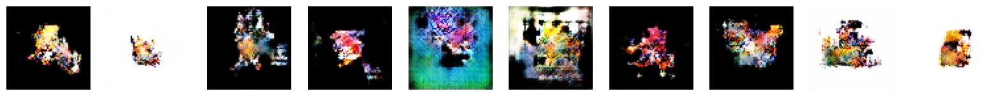

100/100 [==============================] - 86s 859ms/step - c_loss: -6.6578 - c_wass_loss: -7.7329 - c_gp: 0.1075 - g_loss: -19.8310
Epoch 52/200
100/100 [==============================] - ETA: 0s - c_loss: -6.4645 - c_wass_loss: -7.4952 - c_gp: 0.1031 - g_loss: -13.4052
Saved to ./output/generated_img_051.png


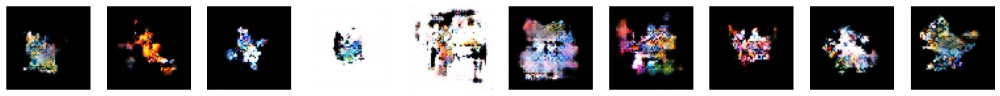

100/100 [==============================] - 87s 866ms/step - c_loss: -6.4645 - c_wass_loss: -7.4952 - c_gp: 0.1031 - g_loss: -13.4052
Epoch 53/200
100/100 [==============================] - ETA: 0s - c_loss: -6.3717 - c_wass_loss: -7.3928 - c_gp: 0.1021 - g_loss: -11.3922
Saved to ./output/generated_img_052.png


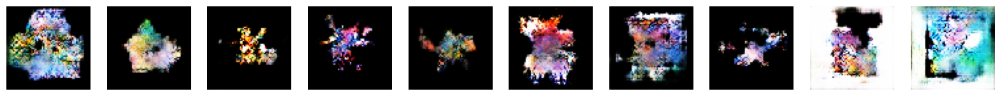

100/100 [==============================] - 86s 860ms/step - c_loss: -6.3717 - c_wass_loss: -7.3928 - c_gp: 0.1021 - g_loss: -11.3922
Epoch 54/200
100/100 [==============================] - ETA: 0s - c_loss: -6.4152 - c_wass_loss: -7.4543 - c_gp: 0.1039 - g_loss: -3.8598
Saved to ./output/generated_img_053.png


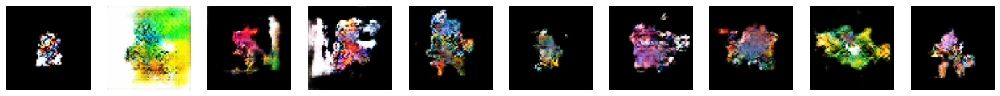

100/100 [==============================] - 86s 865ms/step - c_loss: -6.4152 - c_wass_loss: -7.4543 - c_gp: 0.1039 - g_loss: -3.8598
Epoch 55/200
100/100 [==============================] - ETA: 0s - c_loss: -6.3028 - c_wass_loss: -7.2630 - c_gp: 0.0960 - g_loss: -10.4891
Saved to ./output/generated_img_054.png


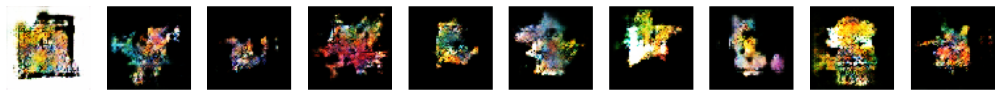

100/100 [==============================] - 86s 861ms/step - c_loss: -6.3028 - c_wass_loss: -7.2630 - c_gp: 0.0960 - g_loss: -10.4891
Epoch 56/200
100/100 [==============================] - ETA: 0s - c_loss: -6.2821 - c_wass_loss: -7.2792 - c_gp: 0.0997 - g_loss: -5.5170
Saved to ./output/generated_img_055.png


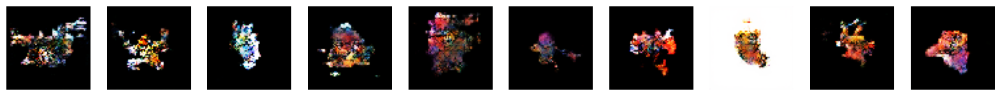

100/100 [==============================] - 87s 874ms/step - c_loss: -6.2821 - c_wass_loss: -7.2792 - c_gp: 0.0997 - g_loss: -5.5170
Epoch 57/200
100/100 [==============================] - ETA: 0s - c_loss: -6.4774 - c_wass_loss: -7.4893 - c_gp: 0.1012 - g_loss: -5.1786
Saved to ./output/generated_img_056.png


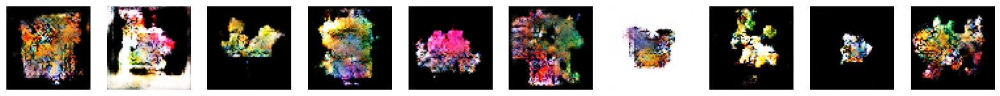

100/100 [==============================] - 86s 858ms/step - c_loss: -6.4774 - c_wass_loss: -7.4893 - c_gp: 0.1012 - g_loss: -5.1786
Epoch 58/200
100/100 [==============================] - ETA: 0s - c_loss: -6.4565 - c_wass_loss: -7.5023 - c_gp: 0.1046 - g_loss: -4.7644
Saved to ./output/generated_img_057.png


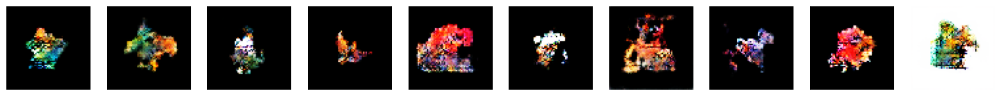

100/100 [==============================] - 86s 856ms/step - c_loss: -6.4565 - c_wass_loss: -7.5023 - c_gp: 0.1046 - g_loss: -4.7644
Epoch 59/200
100/100 [==============================] - ETA: 0s - c_loss: -6.3532 - c_wass_loss: -7.3613 - c_gp: 0.1008 - g_loss: -5.8726
Saved to ./output/generated_img_058.png


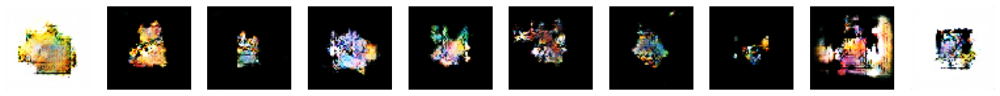

100/100 [==============================] - 87s 867ms/step - c_loss: -6.3532 - c_wass_loss: -7.3613 - c_gp: 0.1008 - g_loss: -5.8726
Epoch 60/200
100/100 [==============================] - ETA: 0s - c_loss: -6.4784 - c_wass_loss: -7.4499 - c_gp: 0.0971 - g_loss: -5.2011
Saved to ./output/generated_img_059.png


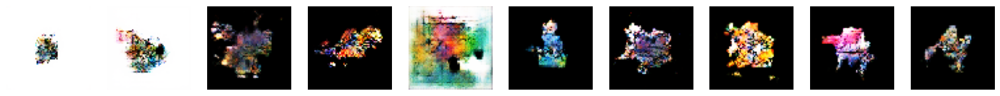

100/100 [==============================] - 86s 858ms/step - c_loss: -6.4784 - c_wass_loss: -7.4499 - c_gp: 0.0971 - g_loss: -5.2011
Epoch 61/200
100/100 [==============================] - ETA: 0s - c_loss: -6.4250 - c_wass_loss: -7.4418 - c_gp: 0.1017 - g_loss: -5.4598
Saved to ./output/generated_img_060.png


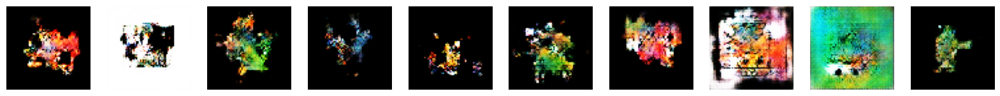

100/100 [==============================] - 87s 870ms/step - c_loss: -6.4250 - c_wass_loss: -7.4418 - c_gp: 0.1017 - g_loss: -5.4598
Epoch 62/200
100/100 [==============================] - ETA: 0s - c_loss: -6.2808 - c_wass_loss: -7.2508 - c_gp: 0.0970 - g_loss: -3.7991
Saved to ./output/generated_img_061.png


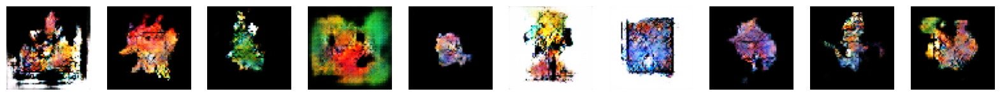

100/100 [==============================] - 87s 868ms/step - c_loss: -6.2808 - c_wass_loss: -7.2508 - c_gp: 0.0970 - g_loss: -3.7991
Epoch 63/200
100/100 [==============================] - ETA: 0s - c_loss: -6.2657 - c_wass_loss: -7.2346 - c_gp: 0.0969 - g_loss: 0.4136
Saved to ./output/generated_img_062.png


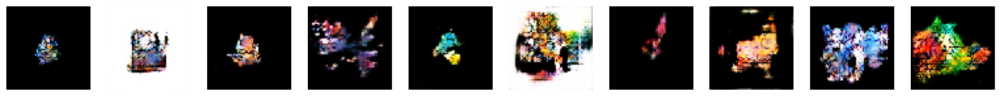

100/100 [==============================] - 87s 864ms/step - c_loss: -6.2657 - c_wass_loss: -7.2346 - c_gp: 0.0969 - g_loss: 0.4136
Epoch 64/200
100/100 [==============================] - ETA: 0s - c_loss: -6.3174 - c_wass_loss: -7.3403 - c_gp: 0.1023 - g_loss: 3.6859
Saved to ./output/generated_img_063.png


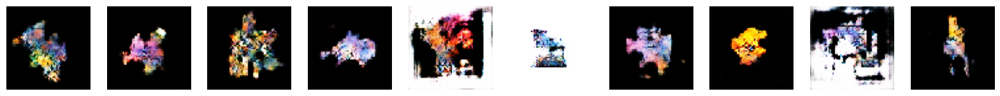

100/100 [==============================] - 86s 860ms/step - c_loss: -6.3174 - c_wass_loss: -7.3403 - c_gp: 0.1023 - g_loss: 3.6859
Epoch 65/200
100/100 [==============================] - ETA: 0s - c_loss: -6.1969 - c_wass_loss: -7.1529 - c_gp: 0.0956 - g_loss: -2.6195
Saved to ./output/generated_img_064.png


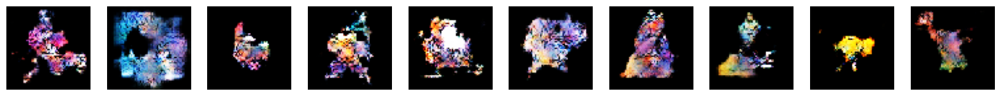

100/100 [==============================] - 87s 867ms/step - c_loss: -6.1969 - c_wass_loss: -7.1529 - c_gp: 0.0956 - g_loss: -2.6195
Epoch 66/200
100/100 [==============================] - ETA: 0s - c_loss: -6.1524 - c_wass_loss: -7.1230 - c_gp: 0.0971 - g_loss: -11.6816
Saved to ./output/generated_img_065.png


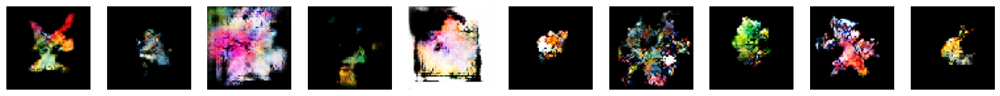

100/100 [==============================] - 86s 859ms/step - c_loss: -6.1524 - c_wass_loss: -7.1230 - c_gp: 0.0971 - g_loss: -11.6816
Epoch 67/200
100/100 [==============================] - ETA: 0s - c_loss: -6.1766 - c_wass_loss: -7.1329 - c_gp: 0.0956 - g_loss: -8.1012
Saved to ./output/generated_img_066.png


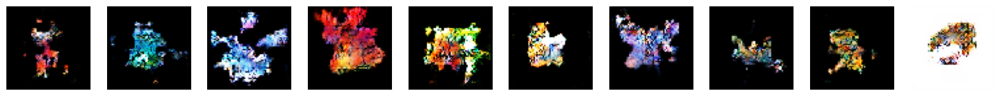

100/100 [==============================] - 86s 857ms/step - c_loss: -6.1766 - c_wass_loss: -7.1329 - c_gp: 0.0956 - g_loss: -8.1012
Epoch 68/200
100/100 [==============================] - ETA: 0s - c_loss: -6.1984 - c_wass_loss: -7.2226 - c_gp: 0.1024 - g_loss: -3.9419
Saved to ./output/generated_img_067.png


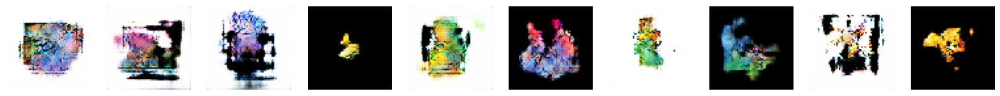

100/100 [==============================] - 87s 870ms/step - c_loss: -6.1984 - c_wass_loss: -7.2226 - c_gp: 0.1024 - g_loss: -3.9419
Epoch 69/200
100/100 [==============================] - ETA: 0s - c_loss: -5.8732 - c_wass_loss: -6.7602 - c_gp: 0.0887 - g_loss: -4.1386
Saved to ./output/generated_img_068.png


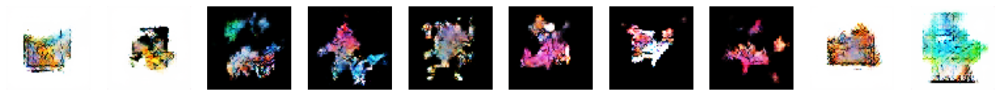

100/100 [==============================] - 86s 860ms/step - c_loss: -5.8732 - c_wass_loss: -6.7602 - c_gp: 0.0887 - g_loss: -4.1386
Epoch 70/200
100/100 [==============================] - ETA: 0s - c_loss: -6.1802 - c_wass_loss: -7.1625 - c_gp: 0.0982 - g_loss: -9.5850
Saved to ./output/generated_img_069.png


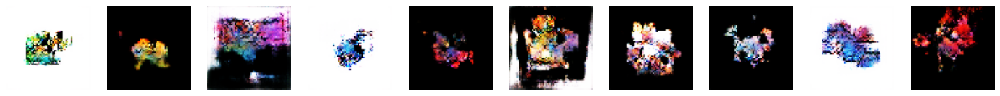

100/100 [==============================] - 87s 866ms/step - c_loss: -6.1802 - c_wass_loss: -7.1625 - c_gp: 0.0982 - g_loss: -9.5850
Epoch 71/200
100/100 [==============================] - ETA: 0s - c_loss: -5.7504 - c_wass_loss: -6.7035 - c_gp: 0.0953 - g_loss: 4.4078
Saved to ./output/generated_img_070.png


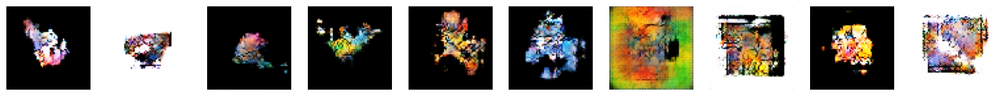

100/100 [==============================] - 86s 861ms/step - c_loss: -5.7504 - c_wass_loss: -6.7035 - c_gp: 0.0953 - g_loss: 4.4078
Epoch 72/200
100/100 [==============================] - ETA: 0s - c_loss: -6.0071 - c_wass_loss: -6.8851 - c_gp: 0.0878 - g_loss: -4.8539
Saved to ./output/generated_img_071.png


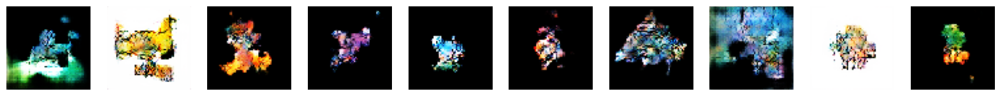

100/100 [==============================] - 87s 869ms/step - c_loss: -6.0071 - c_wass_loss: -6.8851 - c_gp: 0.0878 - g_loss: -4.8539
Epoch 73/200
100/100 [==============================] - ETA: 0s - c_loss: -5.7723 - c_wass_loss: -6.6737 - c_gp: 0.0901 - g_loss: -1.5001
Saved to ./output/generated_img_072.png


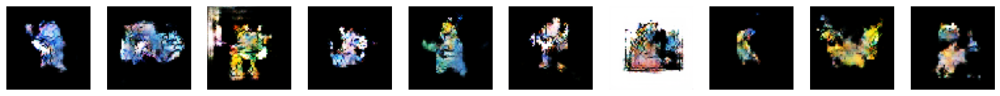

100/100 [==============================] - 86s 857ms/step - c_loss: -5.7723 - c_wass_loss: -6.6737 - c_gp: 0.0901 - g_loss: -1.5001
Epoch 74/200
100/100 [==============================] - ETA: 0s - c_loss: -5.8448 - c_wass_loss: -6.7527 - c_gp: 0.0908 - g_loss: 2.7209
Saved to ./output/generated_img_073.png


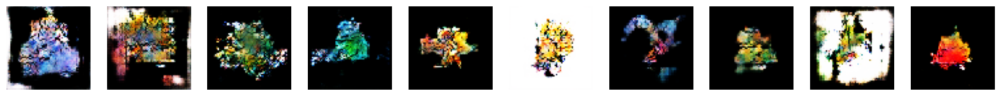

100/100 [==============================] - 87s 871ms/step - c_loss: -5.8448 - c_wass_loss: -6.7527 - c_gp: 0.0908 - g_loss: 2.7209
Epoch 75/200
100/100 [==============================] - ETA: 0s - c_loss: -5.8546 - c_wass_loss: -6.7854 - c_gp: 0.0931 - g_loss: -3.1044
Saved to ./output/generated_img_074.png


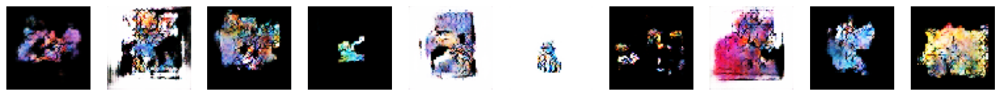

100/100 [==============================] - 86s 859ms/step - c_loss: -5.8546 - c_wass_loss: -6.7854 - c_gp: 0.0931 - g_loss: -3.1044
Epoch 76/200
100/100 [==============================] - ETA: 0s - c_loss: -5.9431 - c_wass_loss: -6.8786 - c_gp: 0.0935 - g_loss: -5.1835
Saved to ./output/generated_img_075.png


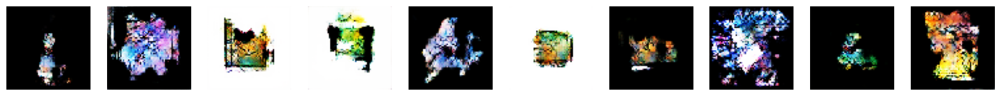

100/100 [==============================] - 86s 863ms/step - c_loss: -5.9431 - c_wass_loss: -6.8786 - c_gp: 0.0935 - g_loss: -5.1835
Epoch 77/200
100/100 [==============================] - ETA: 0s - c_loss: -5.8502 - c_wass_loss: -6.7257 - c_gp: 0.0875 - g_loss: -4.8000
Saved to ./output/generated_img_076.png


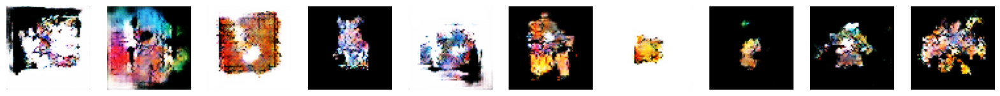

100/100 [==============================] - 86s 859ms/step - c_loss: -5.8502 - c_wass_loss: -6.7257 - c_gp: 0.0875 - g_loss: -4.8000
Epoch 78/200
100/100 [==============================] - ETA: 0s - c_loss: -5.8663 - c_wass_loss: -6.7864 - c_gp: 0.0920 - g_loss: -4.0055
Saved to ./output/generated_img_077.png


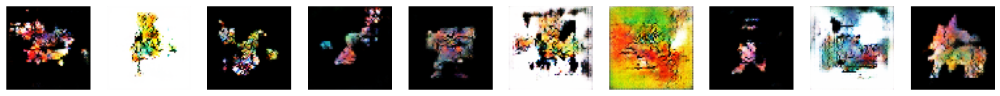

100/100 [==============================] - 86s 858ms/step - c_loss: -5.8663 - c_wass_loss: -6.7864 - c_gp: 0.0920 - g_loss: -4.0055
Epoch 79/200
100/100 [==============================] - ETA: 0s - c_loss: -5.5489 - c_wass_loss: -6.4065 - c_gp: 0.0858 - g_loss: 2.4855
Saved to ./output/generated_img_078.png


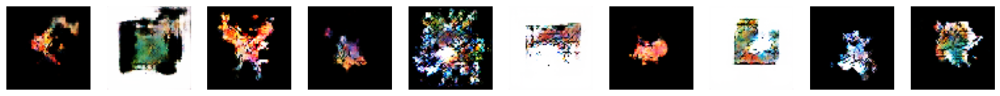

100/100 [==============================] - 86s 865ms/step - c_loss: -5.5489 - c_wass_loss: -6.4065 - c_gp: 0.0858 - g_loss: 2.4855
Epoch 80/200
100/100 [==============================] - ETA: 0s - c_loss: -5.7614 - c_wass_loss: -6.6639 - c_gp: 0.0903 - g_loss: 3.1962
Saved to ./output/generated_img_079.png


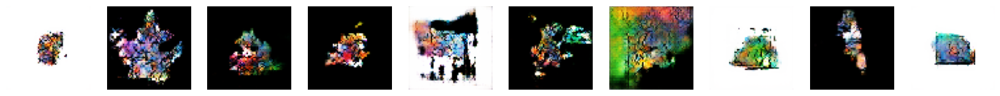

100/100 [==============================] - 86s 862ms/step - c_loss: -5.7614 - c_wass_loss: -6.6639 - c_gp: 0.0903 - g_loss: 3.1962
Epoch 81/200
100/100 [==============================] - ETA: 0s - c_loss: -5.5553 - c_wass_loss: -6.4155 - c_gp: 0.0860 - g_loss: 5.3778
Saved to ./output/generated_img_080.png


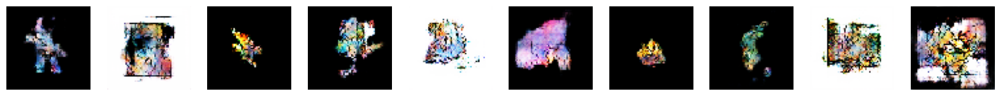

100/100 [==============================] - 87s 865ms/step - c_loss: -5.5553 - c_wass_loss: -6.4155 - c_gp: 0.0860 - g_loss: 5.3778
Epoch 82/200
100/100 [==============================] - ETA: 0s - c_loss: -5.5009 - c_wass_loss: -6.3826 - c_gp: 0.0882 - g_loss: 12.0824
Saved to ./output/generated_img_081.png


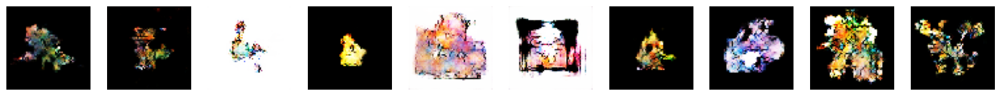

100/100 [==============================] - 86s 855ms/step - c_loss: -5.5009 - c_wass_loss: -6.3826 - c_gp: 0.0882 - g_loss: 12.0824
Epoch 83/200
100/100 [==============================] - ETA: 0s - c_loss: -5.6200 - c_wass_loss: -6.4623 - c_gp: 0.0842 - g_loss: 3.4733
Saved to ./output/generated_img_082.png


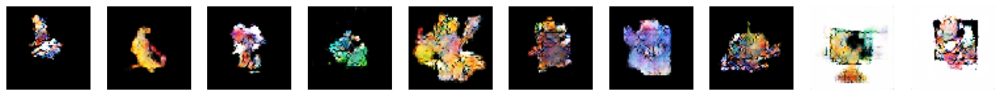

100/100 [==============================] - 87s 867ms/step - c_loss: -5.6200 - c_wass_loss: -6.4623 - c_gp: 0.0842 - g_loss: 3.4733
Epoch 84/200
100/100 [==============================] - ETA: 0s - c_loss: -5.4687 - c_wass_loss: -6.3131 - c_gp: 0.0844 - g_loss: 3.7795
Saved to ./output/generated_img_083.png


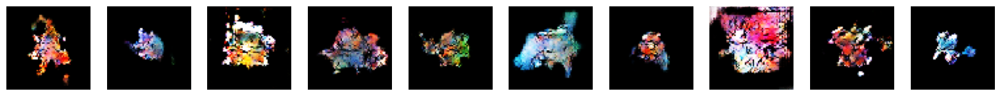

100/100 [==============================] - 86s 857ms/step - c_loss: -5.4687 - c_wass_loss: -6.3131 - c_gp: 0.0844 - g_loss: 3.7795
Epoch 85/200
100/100 [==============================] - ETA: 0s - c_loss: -5.2112 - c_wass_loss: -6.0310 - c_gp: 0.0820 - g_loss: 1.5794
Saved to ./output/generated_img_084.png


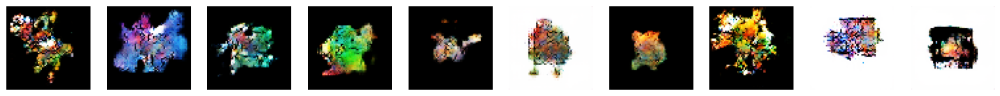

100/100 [==============================] - 87s 870ms/step - c_loss: -5.2112 - c_wass_loss: -6.0310 - c_gp: 0.0820 - g_loss: 1.5794
Epoch 86/200
100/100 [==============================] - ETA: 0s - c_loss: -5.8432 - c_wass_loss: -6.7582 - c_gp: 0.0915 - g_loss: 5.3327
Saved to ./output/generated_img_085.png


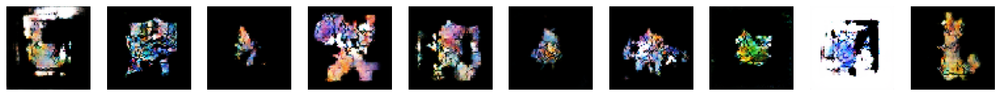

100/100 [==============================] - 86s 862ms/step - c_loss: -5.8432 - c_wass_loss: -6.7582 - c_gp: 0.0915 - g_loss: 5.3327
Epoch 87/200
100/100 [==============================] - ETA: 0s - c_loss: -5.3483 - c_wass_loss: -6.1663 - c_gp: 0.0818 - g_loss: 5.3858
Saved to ./output/generated_img_086.png


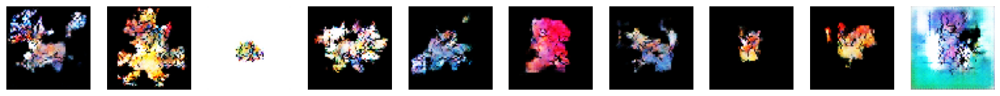

100/100 [==============================] - 86s 859ms/step - c_loss: -5.3483 - c_wass_loss: -6.1663 - c_gp: 0.0818 - g_loss: 5.3858
Epoch 88/200
100/100 [==============================] - ETA: 0s - c_loss: -5.4086 - c_wass_loss: -6.2103 - c_gp: 0.0802 - g_loss: 9.8954 
Saved to ./output/generated_img_087.png


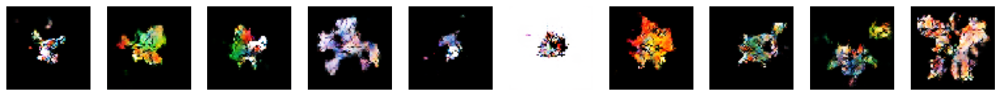

100/100 [==============================] - 87s 866ms/step - c_loss: -5.4086 - c_wass_loss: -6.2103 - c_gp: 0.0802 - g_loss: 9.8954
Epoch 89/200
100/100 [==============================] - ETA: 0s - c_loss: -5.7159 - c_wass_loss: -6.5817 - c_gp: 0.0866 - g_loss: 18.5568
Saved to ./output/generated_img_088.png


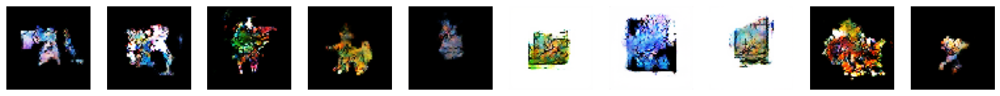

100/100 [==============================] - 85s 855ms/step - c_loss: -5.7159 - c_wass_loss: -6.5817 - c_gp: 0.0866 - g_loss: 18.5568
Epoch 90/200
100/100 [==============================] - ETA: 0s - c_loss: -5.4373 - c_wass_loss: -6.2399 - c_gp: 0.0803 - g_loss: 9.0719
Saved to ./output/generated_img_089.png


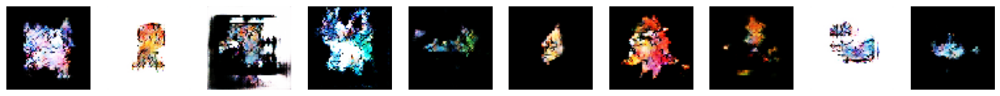

100/100 [==============================] - 87s 869ms/step - c_loss: -5.4373 - c_wass_loss: -6.2399 - c_gp: 0.0803 - g_loss: 9.0719
Epoch 91/200
100/100 [==============================] - ETA: 0s - c_loss: -5.1719 - c_wass_loss: -5.9658 - c_gp: 0.0794 - g_loss: -7.8335
Saved to ./output/generated_img_090.png


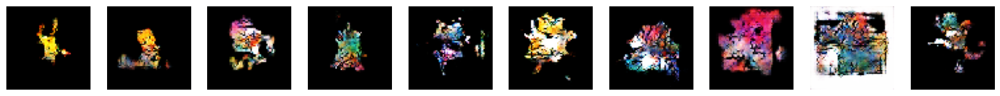

100/100 [==============================] - 86s 859ms/step - c_loss: -5.1719 - c_wass_loss: -5.9658 - c_gp: 0.0794 - g_loss: -7.8335
Epoch 92/200
100/100 [==============================] - ETA: 0s - c_loss: -5.2630 - c_wass_loss: -6.0766 - c_gp: 0.0814 - g_loss: -6.6367
Saved to ./output/generated_img_091.png


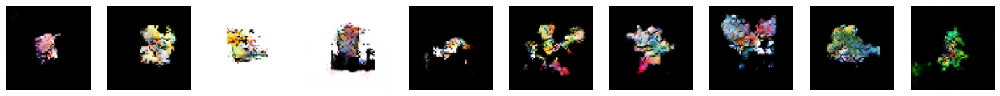

100/100 [==============================] - 86s 865ms/step - c_loss: -5.2630 - c_wass_loss: -6.0766 - c_gp: 0.0814 - g_loss: -6.6367
Epoch 93/200
100/100 [==============================] - ETA: 0s - c_loss: -5.2199 - c_wass_loss: -6.0138 - c_gp: 0.0794 - g_loss: -5.3986
Saved to ./output/generated_img_092.png


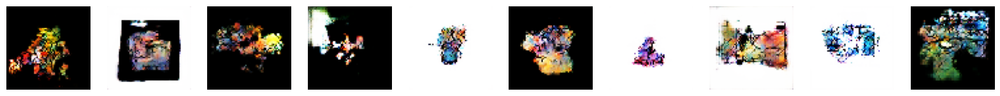

100/100 [==============================] - 87s 865ms/step - c_loss: -5.2199 - c_wass_loss: -6.0138 - c_gp: 0.0794 - g_loss: -5.3986
Epoch 94/200
100/100 [==============================] - ETA: 0s - c_loss: -5.2241 - c_wass_loss: -6.0374 - c_gp: 0.0813 - g_loss: 8.4262
Saved to ./output/generated_img_093.png


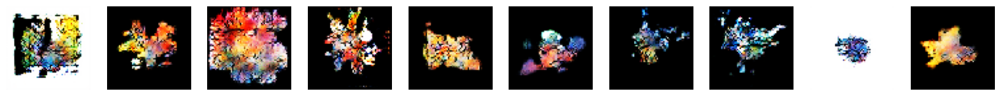

100/100 [==============================] - 87s 874ms/step - c_loss: -5.2241 - c_wass_loss: -6.0374 - c_gp: 0.0813 - g_loss: 8.4262
Epoch 95/200
100/100 [==============================] - ETA: 0s - c_loss: -5.4554 - c_wass_loss: -6.2561 - c_gp: 0.0801 - g_loss: 1.1839
Saved to ./output/generated_img_094.png


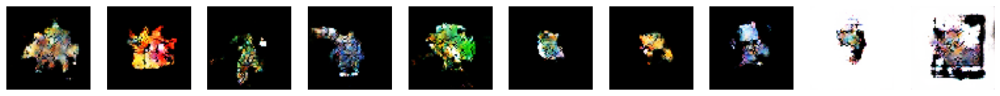

100/100 [==============================] - 86s 860ms/step - c_loss: -5.4554 - c_wass_loss: -6.2561 - c_gp: 0.0801 - g_loss: 1.1839
Epoch 96/200
100/100 [==============================] - ETA: 0s - c_loss: -5.3003 - c_wass_loss: -6.0849 - c_gp: 0.0785 - g_loss: 11.6572
Saved to ./output/generated_img_095.png


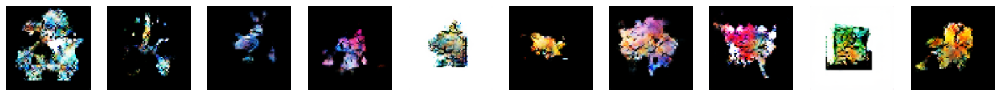

100/100 [==============================] - 86s 858ms/step - c_loss: -5.3003 - c_wass_loss: -6.0849 - c_gp: 0.0785 - g_loss: 11.6572
Epoch 97/200
100/100 [==============================] - ETA: 0s - c_loss: -5.4143 - c_wass_loss: -6.2168 - c_gp: 0.0803 - g_loss: 8.5956
Saved to ./output/generated_img_096.png


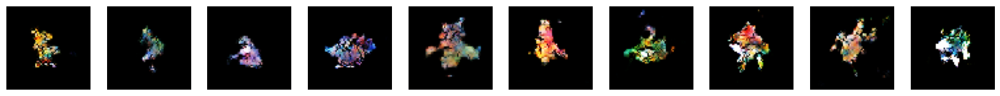

100/100 [==============================] - 86s 864ms/step - c_loss: -5.4143 - c_wass_loss: -6.2168 - c_gp: 0.0803 - g_loss: 8.5956
Epoch 98/200
100/100 [==============================] - ETA: 0s - c_loss: -5.2984 - c_wass_loss: -6.0572 - c_gp: 0.0759 - g_loss: 1.7232
Saved to ./output/generated_img_097.png


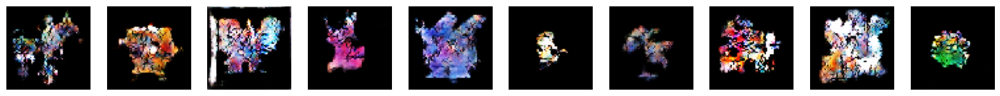

100/100 [==============================] - 86s 856ms/step - c_loss: -5.2984 - c_wass_loss: -6.0572 - c_gp: 0.0759 - g_loss: 1.7232
Epoch 99/200
100/100 [==============================] - ETA: 0s - c_loss: -5.2413 - c_wass_loss: -6.0059 - c_gp: 0.0765 - g_loss: 7.3681
Saved to ./output/generated_img_098.png


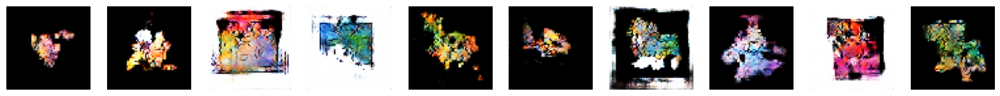

100/100 [==============================] - 87s 869ms/step - c_loss: -5.2413 - c_wass_loss: -6.0059 - c_gp: 0.0765 - g_loss: 7.3681
Epoch 100/200
100/100 [==============================] - ETA: 0s - c_loss: -5.2290 - c_wass_loss: -6.0601 - c_gp: 0.0831 - g_loss: 12.0190
Saved to ./output/generated_img_099.png


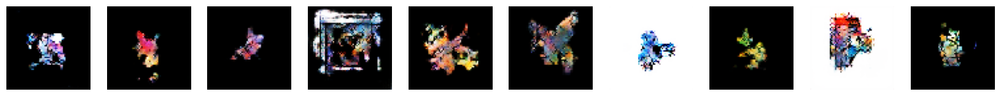

100/100 [==============================] - 86s 858ms/step - c_loss: -5.2290 - c_wass_loss: -6.0601 - c_gp: 0.0831 - g_loss: 12.0190
Epoch 101/200
100/100 [==============================] - ETA: 0s - c_loss: -5.2341 - c_wass_loss: -5.9886 - c_gp: 0.0755 - g_loss: 5.6725
Saved to ./output/generated_img_100.png


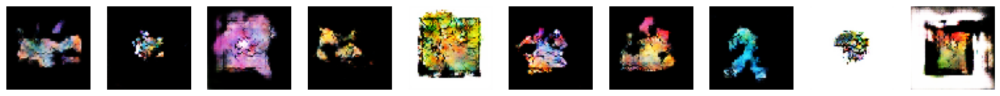

100/100 [==============================] - 87s 866ms/step - c_loss: -5.2341 - c_wass_loss: -5.9886 - c_gp: 0.0755 - g_loss: 5.6725
Epoch 102/200
100/100 [==============================] - ETA: 0s - c_loss: -5.3165 - c_wass_loss: -6.1024 - c_gp: 0.0786 - g_loss: 6.4858
Saved to ./output/generated_img_101.png


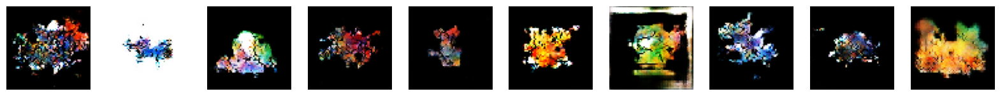

100/100 [==============================] - 86s 859ms/step - c_loss: -5.3165 - c_wass_loss: -6.1024 - c_gp: 0.0786 - g_loss: 6.4858
Epoch 103/200
100/100 [==============================] - ETA: 0s - c_loss: -5.1405 - c_wass_loss: -5.8902 - c_gp: 0.0750 - g_loss: -1.7323
Saved to ./output/generated_img_102.png


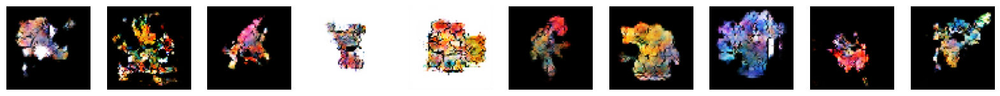

100/100 [==============================] - 87s 870ms/step - c_loss: -5.1405 - c_wass_loss: -5.8902 - c_gp: 0.0750 - g_loss: -1.7323
Epoch 104/200
100/100 [==============================] - ETA: 0s - c_loss: -5.2694 - c_wass_loss: -6.0450 - c_gp: 0.0776 - g_loss: 2.9185
Saved to ./output/generated_img_103.png


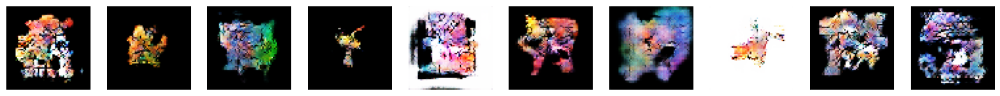

100/100 [==============================] - 86s 860ms/step - c_loss: -5.2694 - c_wass_loss: -6.0450 - c_gp: 0.0776 - g_loss: 2.9185
Epoch 105/200
100/100 [==============================] - ETA: 0s - c_loss: -5.2799 - c_wass_loss: -6.0674 - c_gp: 0.0788 - g_loss: 0.4485
Saved to ./output/generated_img_104.png


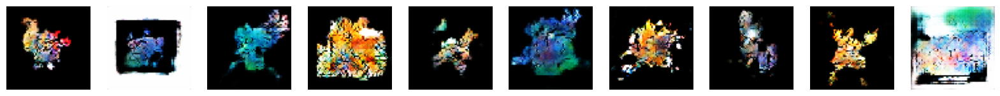

100/100 [==============================] - 86s 861ms/step - c_loss: -5.2799 - c_wass_loss: -6.0674 - c_gp: 0.0788 - g_loss: 0.4485
Epoch 106/200
100/100 [==============================] - ETA: 0s - c_loss: -5.0067 - c_wass_loss: -5.7530 - c_gp: 0.0746 - g_loss: 5.6177
Saved to ./output/generated_img_105.png


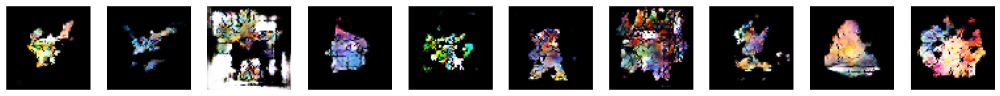

100/100 [==============================] - 87s 868ms/step - c_loss: -5.0067 - c_wass_loss: -5.7530 - c_gp: 0.0746 - g_loss: 5.6177
Epoch 107/200
100/100 [==============================] - ETA: 0s - c_loss: -5.1008 - c_wass_loss: -5.8648 - c_gp: 0.0764 - g_loss: 4.7435
Saved to ./output/generated_img_106.png


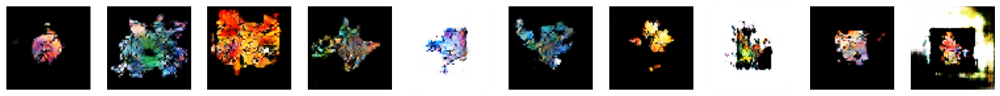

100/100 [==============================] - 86s 859ms/step - c_loss: -5.1008 - c_wass_loss: -5.8648 - c_gp: 0.0764 - g_loss: 4.7435
Epoch 108/200
100/100 [==============================] - ETA: 0s - c_loss: -5.0721 - c_wass_loss: -5.8226 - c_gp: 0.0751 - g_loss: 6.1160
Saved to ./output/generated_img_107.png


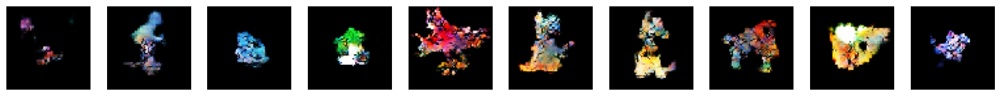

100/100 [==============================] - 87s 866ms/step - c_loss: -5.0721 - c_wass_loss: -5.8226 - c_gp: 0.0751 - g_loss: 6.1160
Epoch 109/200
100/100 [==============================] - ETA: 0s - c_loss: -5.1860 - c_wass_loss: -5.9422 - c_gp: 0.0756 - g_loss: 13.4872
Saved to ./output/generated_img_108.png


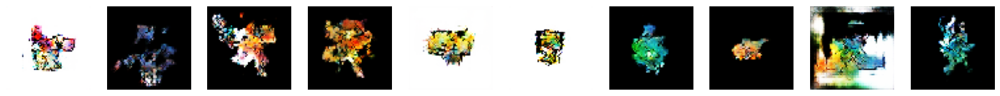

100/100 [==============================] - 86s 855ms/step - c_loss: -5.1860 - c_wass_loss: -5.9422 - c_gp: 0.0756 - g_loss: 13.4872
Epoch 110/200
100/100 [==============================] - ETA: 0s - c_loss: -4.9654 - c_wass_loss: -5.7218 - c_gp: 0.0756 - g_loss: 6.7287
Saved to ./output/generated_img_109.png


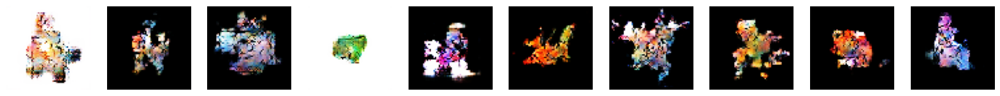

100/100 [==============================] - 86s 863ms/step - c_loss: -4.9654 - c_wass_loss: -5.7218 - c_gp: 0.0756 - g_loss: 6.7287
Epoch 111/200
100/100 [==============================] - ETA: 0s - c_loss: -5.0503 - c_wass_loss: -5.8126 - c_gp: 0.0762 - g_loss: 10.8375
Saved to ./output/generated_img_110.png


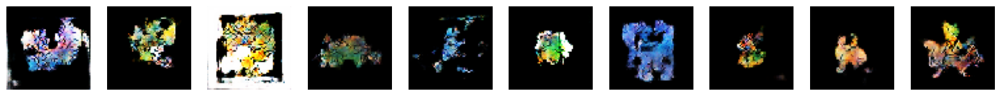

100/100 [==============================] - 86s 862ms/step - c_loss: -5.0503 - c_wass_loss: -5.8126 - c_gp: 0.0762 - g_loss: 10.8375
Epoch 112/200
100/100 [==============================] - ETA: 0s - c_loss: -5.3895 - c_wass_loss: -6.1849 - c_gp: 0.0795 - g_loss: 5.1152
Saved to ./output/generated_img_111.png


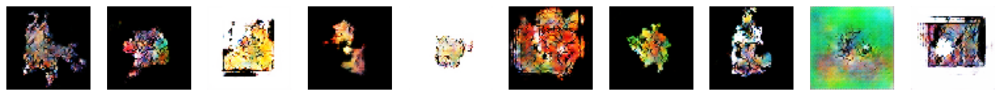

100/100 [==============================] - 86s 865ms/step - c_loss: -5.3895 - c_wass_loss: -6.1849 - c_gp: 0.0795 - g_loss: 5.1152
Epoch 113/200
100/100 [==============================] - ETA: 0s - c_loss: -5.0063 - c_wass_loss: -5.7557 - c_gp: 0.0749 - g_loss: 11.3754
Saved to ./output/generated_img_112.png


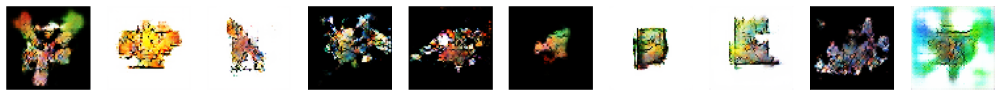

100/100 [==============================] - 86s 862ms/step - c_loss: -5.0063 - c_wass_loss: -5.7557 - c_gp: 0.0749 - g_loss: 11.3754
Epoch 114/200
100/100 [==============================] - ETA: 0s - c_loss: -4.9423 - c_wass_loss: -5.6853 - c_gp: 0.0743 - g_loss: 13.9090
Saved to ./output/generated_img_113.png


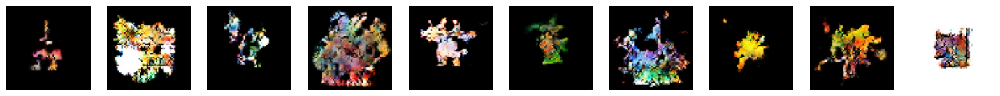

100/100 [==============================] - 87s 865ms/step - c_loss: -4.9423 - c_wass_loss: -5.6853 - c_gp: 0.0743 - g_loss: 13.9090
Epoch 115/200
100/100 [==============================] - ETA: 0s - c_loss: -5.0354 - c_wass_loss: -5.8213 - c_gp: 0.0786 - g_loss: 13.9994
Saved to ./output/generated_img_114.png


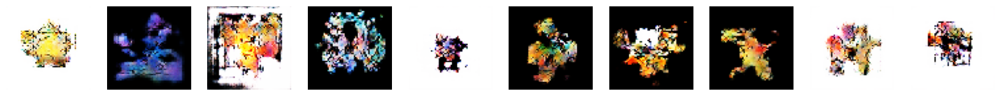

100/100 [==============================] - 86s 860ms/step - c_loss: -5.0354 - c_wass_loss: -5.8213 - c_gp: 0.0786 - g_loss: 13.9994
Epoch 116/200
100/100 [==============================] - ETA: 0s - c_loss: -5.1043 - c_wass_loss: -5.8458 - c_gp: 0.0741 - g_loss: 10.6894
Saved to ./output/generated_img_115.png


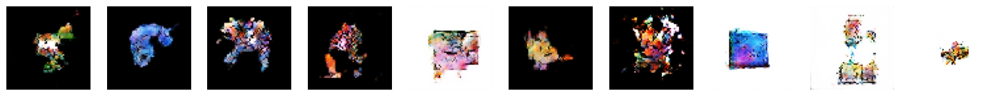

100/100 [==============================] - 86s 859ms/step - c_loss: -5.1043 - c_wass_loss: -5.8458 - c_gp: 0.0741 - g_loss: 10.6894
Epoch 117/200
100/100 [==============================] - ETA: 0s - c_loss: -4.8226 - c_wass_loss: -5.5593 - c_gp: 0.0737 - g_loss: 10.8532
Saved to ./output/generated_img_116.png


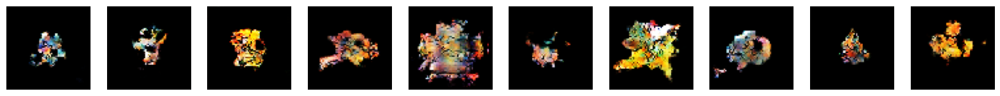

100/100 [==============================] - 87s 866ms/step - c_loss: -4.8226 - c_wass_loss: -5.5593 - c_gp: 0.0737 - g_loss: 10.8532
Epoch 118/200
100/100 [==============================] - ETA: 0s - c_loss: -4.8813 - c_wass_loss: -5.5958 - c_gp: 0.0715 - g_loss: 13.4298
Saved to ./output/generated_img_117.png


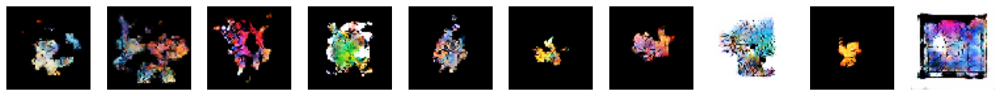

100/100 [==============================] - 86s 859ms/step - c_loss: -4.8813 - c_wass_loss: -5.5958 - c_gp: 0.0715 - g_loss: 13.4298
Epoch 119/200
100/100 [==============================] - ETA: 0s - c_loss: -5.1807 - c_wass_loss: -5.8973 - c_gp: 0.0717 - g_loss: 2.0834
Saved to ./output/generated_img_118.png


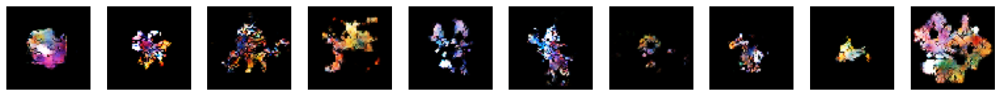

100/100 [==============================] - 87s 866ms/step - c_loss: -5.1807 - c_wass_loss: -5.8973 - c_gp: 0.0717 - g_loss: 2.0834
Epoch 120/200
100/100 [==============================] - ETA: 0s - c_loss: -4.8755 - c_wass_loss: -5.6098 - c_gp: 0.0734 - g_loss: 7.1756
Saved to ./output/generated_img_119.png


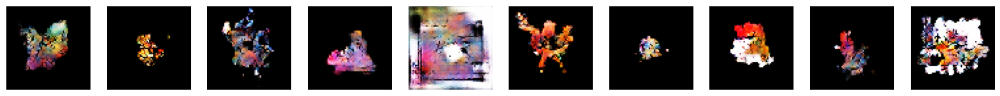

100/100 [==============================] - 86s 860ms/step - c_loss: -4.8755 - c_wass_loss: -5.6098 - c_gp: 0.0734 - g_loss: 7.1756
Epoch 121/200
100/100 [==============================] - ETA: 0s - c_loss: -5.0987 - c_wass_loss: -5.8470 - c_gp: 0.0748 - g_loss: 5.1852
Saved to ./output/generated_img_120.png


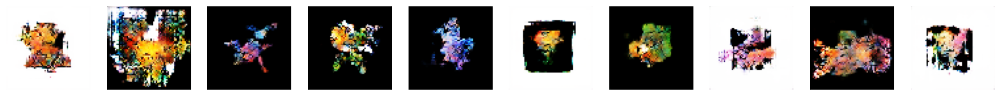

100/100 [==============================] - 86s 865ms/step - c_loss: -5.0987 - c_wass_loss: -5.8470 - c_gp: 0.0748 - g_loss: 5.1852
Epoch 122/200
100/100 [==============================] - ETA: 0s - c_loss: -4.7406 - c_wass_loss: -5.4628 - c_gp: 0.0722 - g_loss: 12.5851
Saved to ./output/generated_img_121.png


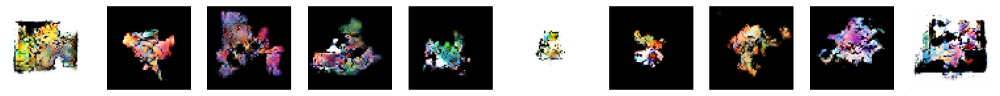

100/100 [==============================] - 86s 860ms/step - c_loss: -4.7406 - c_wass_loss: -5.4628 - c_gp: 0.0722 - g_loss: 12.5851
Epoch 123/200
100/100 [==============================] - ETA: 0s - c_loss: -4.7153 - c_wass_loss: -5.4330 - c_gp: 0.0718 - g_loss: 10.9619
Saved to ./output/generated_img_122.png


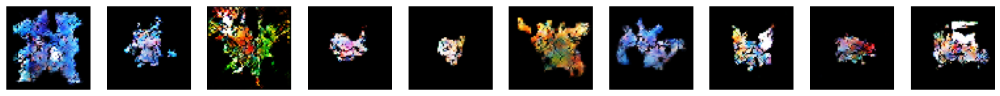

100/100 [==============================] - 87s 870ms/step - c_loss: -4.7153 - c_wass_loss: -5.4330 - c_gp: 0.0718 - g_loss: 10.9619
Epoch 124/200
100/100 [==============================] - ETA: 0s - c_loss: -4.8710 - c_wass_loss: -5.6058 - c_gp: 0.0735 - g_loss: 11.3286
Saved to ./output/generated_img_123.png


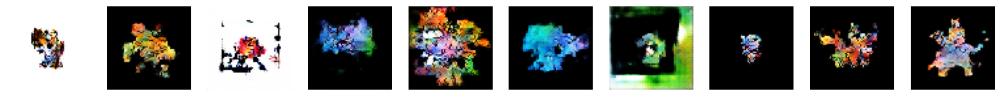

100/100 [==============================] - 86s 862ms/step - c_loss: -4.8710 - c_wass_loss: -5.6058 - c_gp: 0.0735 - g_loss: 11.3286
Epoch 125/200
100/100 [==============================] - ETA: 0s - c_loss: -5.1171 - c_wass_loss: -5.8601 - c_gp: 0.0743 - g_loss: 11.3321
Saved to ./output/generated_img_124.png


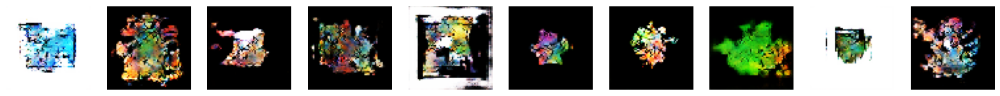

100/100 [==============================] - 86s 858ms/step - c_loss: -5.1171 - c_wass_loss: -5.8601 - c_gp: 0.0743 - g_loss: 11.3321
Epoch 126/200
100/100 [==============================] - ETA: 0s - c_loss: -5.1645 - c_wass_loss: -5.9832 - c_gp: 0.0819 - g_loss: 11.9263
Saved to ./output/generated_img_125.png


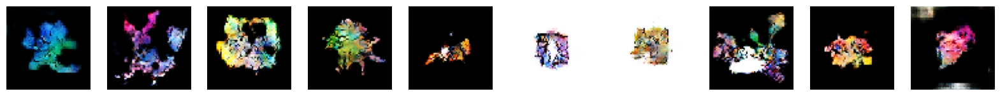

100/100 [==============================] - 87s 868ms/step - c_loss: -5.1645 - c_wass_loss: -5.9832 - c_gp: 0.0819 - g_loss: 11.9263
Epoch 127/200
100/100 [==============================] - ETA: 0s - c_loss: -4.7660 - c_wass_loss: -5.4820 - c_gp: 0.0716 - g_loss: 6.8216
Saved to ./output/generated_img_126.png


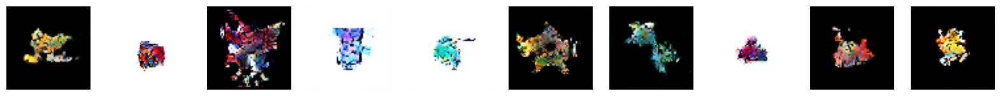

100/100 [==============================] - 86s 859ms/step - c_loss: -4.7660 - c_wass_loss: -5.4820 - c_gp: 0.0716 - g_loss: 6.8216
Epoch 128/200
100/100 [==============================] - ETA: 0s - c_loss: -4.9728 - c_wass_loss: -5.6854 - c_gp: 0.0713 - g_loss: 9.3751
Saved to ./output/generated_img_127.png


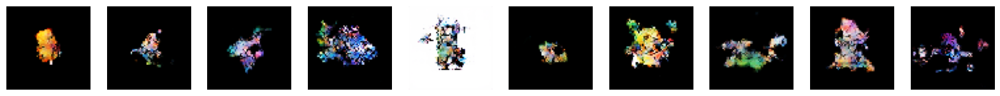

100/100 [==============================] - 87s 867ms/step - c_loss: -4.9728 - c_wass_loss: -5.6854 - c_gp: 0.0713 - g_loss: 9.3751
Epoch 129/200
100/100 [==============================] - ETA: 0s - c_loss: -5.0912 - c_wass_loss: -5.8144 - c_gp: 0.0723 - g_loss: 8.2186
Saved to ./output/generated_img_128.png


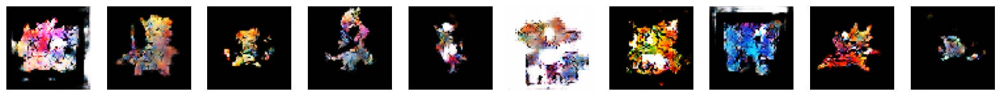

100/100 [==============================] - 86s 859ms/step - c_loss: -5.0912 - c_wass_loss: -5.8144 - c_gp: 0.0723 - g_loss: 8.2186
Epoch 130/200
100/100 [==============================] - ETA: 0s - c_loss: -4.8471 - c_wass_loss: -5.5647 - c_gp: 0.0718 - g_loss: 5.7506
Saved to ./output/generated_img_129.png


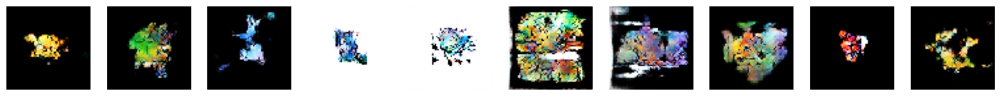

100/100 [==============================] - 87s 866ms/step - c_loss: -4.8471 - c_wass_loss: -5.5647 - c_gp: 0.0718 - g_loss: 5.7506
Epoch 131/200
100/100 [==============================] - ETA: 0s - c_loss: -4.8271 - c_wass_loss: -5.5121 - c_gp: 0.0685 - g_loss: 2.2474
Saved to ./output/generated_img_130.png


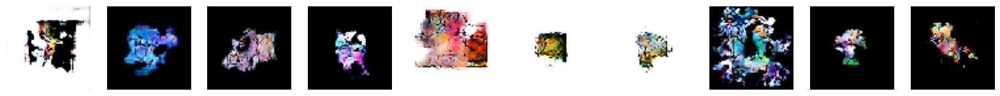

100/100 [==============================] - 86s 856ms/step - c_loss: -4.8271 - c_wass_loss: -5.5121 - c_gp: 0.0685 - g_loss: 2.2474
Epoch 132/200
100/100 [==============================] - ETA: 0s - c_loss: -5.0938 - c_wass_loss: -5.8176 - c_gp: 0.0724 - g_loss: 4.9928
Saved to ./output/generated_img_131.png


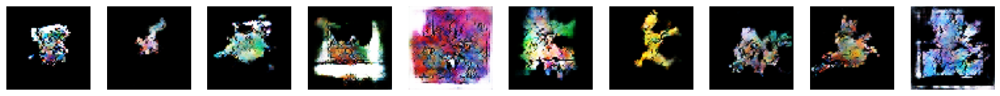

100/100 [==============================] - 87s 871ms/step - c_loss: -5.0938 - c_wass_loss: -5.8176 - c_gp: 0.0724 - g_loss: 4.9928
Epoch 133/200
100/100 [==============================] - ETA: 0s - c_loss: -4.7713 - c_wass_loss: -5.4641 - c_gp: 0.0693 - g_loss: 12.9295
Saved to ./output/generated_img_132.png


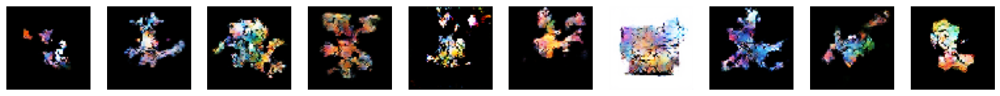

100/100 [==============================] - 86s 856ms/step - c_loss: -4.7713 - c_wass_loss: -5.4641 - c_gp: 0.0693 - g_loss: 12.9295
Epoch 134/200
100/100 [==============================] - ETA: 0s - c_loss: -4.8148 - c_wass_loss: -5.4951 - c_gp: 0.0680 - g_loss: 11.2219
Saved to ./output/generated_img_133.png


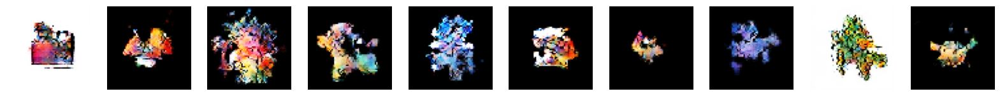

100/100 [==============================] - 86s 859ms/step - c_loss: -4.8148 - c_wass_loss: -5.4951 - c_gp: 0.0680 - g_loss: 11.2219
Epoch 135/200
100/100 [==============================] - ETA: 0s - c_loss: -4.9324 - c_wass_loss: -5.6579 - c_gp: 0.0725 - g_loss: 15.7754
Saved to ./output/generated_img_134.png


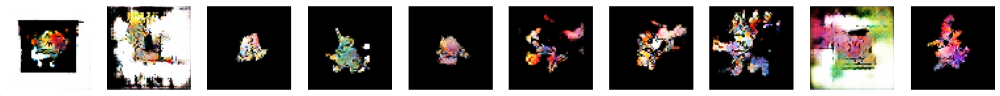

100/100 [==============================] - 86s 861ms/step - c_loss: -4.9324 - c_wass_loss: -5.6579 - c_gp: 0.0725 - g_loss: 15.7754
Epoch 136/200
100/100 [==============================] - ETA: 0s - c_loss: -4.8124 - c_wass_loss: -5.4884 - c_gp: 0.0676 - g_loss: 11.1804
Saved to ./output/generated_img_135.png


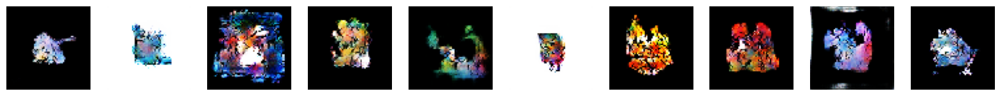

100/100 [==============================] - 86s 858ms/step - c_loss: -4.8124 - c_wass_loss: -5.4884 - c_gp: 0.0676 - g_loss: 11.1804
Epoch 137/200
100/100 [==============================] - ETA: 0s - c_loss: -5.1149 - c_wass_loss: -5.8458 - c_gp: 0.0731 - g_loss: 17.6197
Saved to ./output/generated_img_136.png


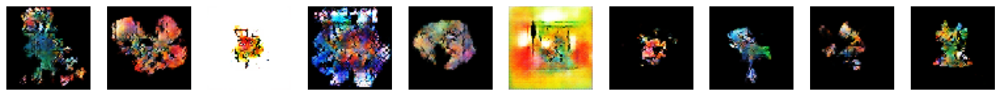

100/100 [==============================] - 87s 866ms/step - c_loss: -5.1149 - c_wass_loss: -5.8458 - c_gp: 0.0731 - g_loss: 17.6197
Epoch 138/200
100/100 [==============================] - ETA: 0s - c_loss: -4.7147 - c_wass_loss: -5.4021 - c_gp: 0.0687 - g_loss: -0.1924
Saved to ./output/generated_img_137.png


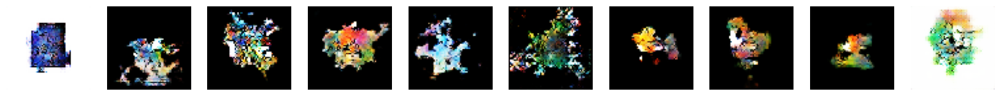

100/100 [==============================] - 86s 856ms/step - c_loss: -4.7147 - c_wass_loss: -5.4021 - c_gp: 0.0687 - g_loss: -0.1924
Epoch 139/200
100/100 [==============================] - ETA: 0s - c_loss: -4.7325 - c_wass_loss: -5.4515 - c_gp: 0.0719 - g_loss: 4.6744
Saved to ./output/generated_img_138.png


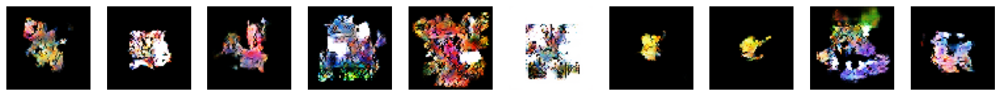

100/100 [==============================] - 86s 864ms/step - c_loss: -4.7325 - c_wass_loss: -5.4515 - c_gp: 0.0719 - g_loss: 4.6744
Epoch 140/200
100/100 [==============================] - ETA: 0s - c_loss: -4.7033 - c_wass_loss: -5.3702 - c_gp: 0.0667 - g_loss: 13.0851
Saved to ./output/generated_img_139.png


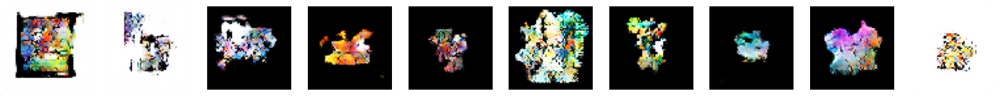

100/100 [==============================] - 86s 858ms/step - c_loss: -4.7033 - c_wass_loss: -5.3702 - c_gp: 0.0667 - g_loss: 13.0851
Epoch 141/200
100/100 [==============================] - ETA: 0s - c_loss: -4.6453 - c_wass_loss: -5.3336 - c_gp: 0.0688 - g_loss: 14.0275
Saved to ./output/generated_img_140.png


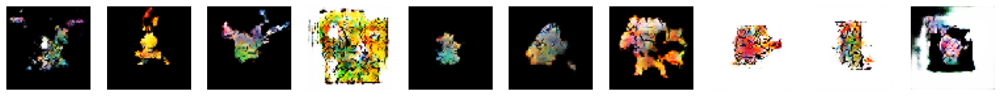

100/100 [==============================] - 86s 863ms/step - c_loss: -4.6453 - c_wass_loss: -5.3336 - c_gp: 0.0688 - g_loss: 14.0275
Epoch 142/200
100/100 [==============================] - ETA: 0s - c_loss: -4.8212 - c_wass_loss: -5.5386 - c_gp: 0.0717 - g_loss: 18.5462
Saved to ./output/generated_img_141.png


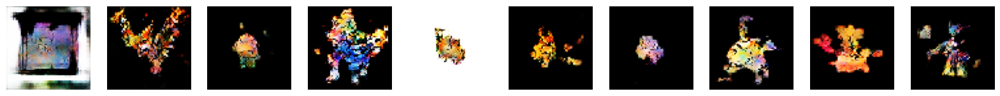

100/100 [==============================] - 86s 861ms/step - c_loss: -4.8212 - c_wass_loss: -5.5386 - c_gp: 0.0717 - g_loss: 18.5462
Epoch 143/200
100/100 [==============================] - ETA: 0s - c_loss: -5.0442 - c_wass_loss: -5.7728 - c_gp: 0.0729 - g_loss: 7.5564
Saved to ./output/generated_img_142.png


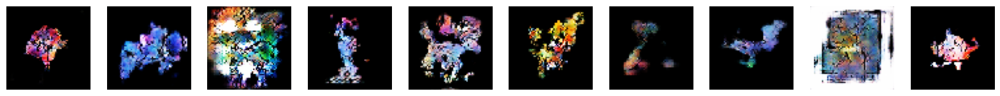

100/100 [==============================] - 86s 858ms/step - c_loss: -5.0442 - c_wass_loss: -5.7728 - c_gp: 0.0729 - g_loss: 7.5564
Epoch 144/200
100/100 [==============================] - ETA: 0s - c_loss: -4.7312 - c_wass_loss: -5.4557 - c_gp: 0.0724 - g_loss: 28.7644
Saved to ./output/generated_img_143.png


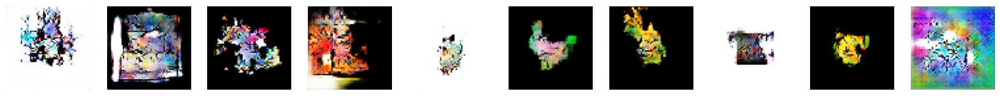

100/100 [==============================] - 86s 862ms/step - c_loss: -4.7312 - c_wass_loss: -5.4557 - c_gp: 0.0724 - g_loss: 28.7644
Epoch 145/200
100/100 [==============================] - ETA: 0s - c_loss: -4.9907 - c_wass_loss: -5.7090 - c_gp: 0.0718 - g_loss: 17.7797
Saved to ./output/generated_img_144.png


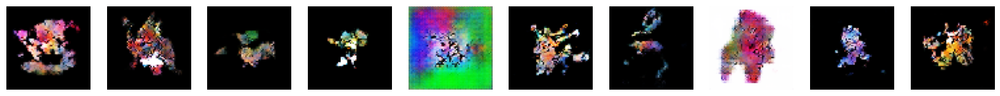

100/100 [==============================] - 85s 855ms/step - c_loss: -4.9907 - c_wass_loss: -5.7090 - c_gp: 0.0718 - g_loss: 17.7797
Epoch 146/200
100/100 [==============================] - ETA: 0s - c_loss: -4.7544 - c_wass_loss: -5.4160 - c_gp: 0.0662 - g_loss: 22.5852
Saved to ./output/generated_img_145.png


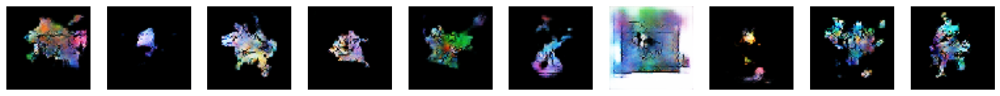

100/100 [==============================] - 87s 866ms/step - c_loss: -4.7544 - c_wass_loss: -5.4160 - c_gp: 0.0662 - g_loss: 22.5852
Epoch 147/200
100/100 [==============================] - ETA: 0s - c_loss: -4.7290 - c_wass_loss: -5.4156 - c_gp: 0.0687 - g_loss: 21.5160
Saved to ./output/generated_img_146.png


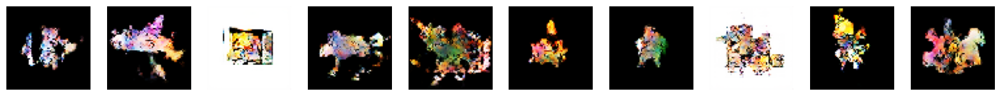

100/100 [==============================] - 86s 856ms/step - c_loss: -4.7290 - c_wass_loss: -5.4156 - c_gp: 0.0687 - g_loss: 21.5160
Epoch 148/200
100/100 [==============================] - ETA: 0s - c_loss: -4.5793 - c_wass_loss: -5.2807 - c_gp: 0.0701 - g_loss: 21.7628
Saved to ./output/generated_img_147.png


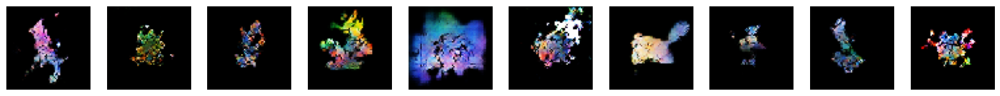

100/100 [==============================] - 87s 866ms/step - c_loss: -4.5793 - c_wass_loss: -5.2807 - c_gp: 0.0701 - g_loss: 21.7628
Epoch 149/200
100/100 [==============================] - ETA: 0s - c_loss: -4.9264 - c_wass_loss: -5.6145 - c_gp: 0.0688 - g_loss: 14.1423
Saved to ./output/generated_img_148.png


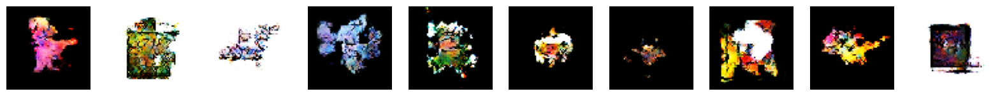

100/100 [==============================] - 85s 855ms/step - c_loss: -4.9264 - c_wass_loss: -5.6145 - c_gp: 0.0688 - g_loss: 14.1423
Epoch 150/200
100/100 [==============================] - ETA: 0s - c_loss: -4.8355 - c_wass_loss: -5.4822 - c_gp: 0.0647 - g_loss: 15.0765
Saved to ./output/generated_img_149.png


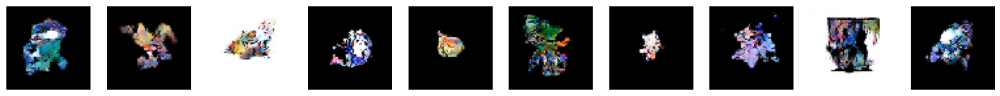

100/100 [==============================] - 86s 863ms/step - c_loss: -4.8355 - c_wass_loss: -5.4822 - c_gp: 0.0647 - g_loss: 15.0765
Epoch 151/200
100/100 [==============================] - ETA: 0s - c_loss: -4.7224 - c_wass_loss: -5.4290 - c_gp: 0.0707 - g_loss: 14.3135
Saved to ./output/generated_img_150.png


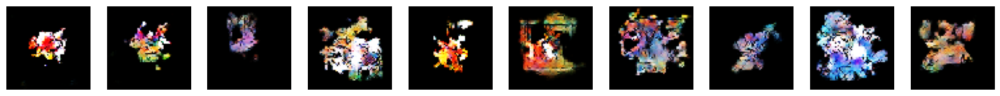

100/100 [==============================] - 86s 857ms/step - c_loss: -4.7224 - c_wass_loss: -5.4290 - c_gp: 0.0707 - g_loss: 14.3135
Epoch 152/200
100/100 [==============================] - ETA: 0s - c_loss: -4.9553 - c_wass_loss: -5.6495 - c_gp: 0.0694 - g_loss: 15.5480
Saved to ./output/generated_img_151.png


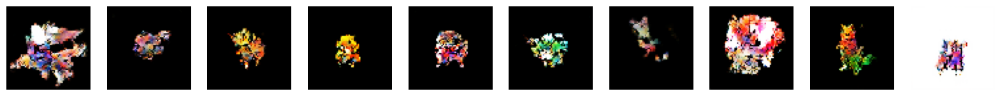

100/100 [==============================] - 86s 864ms/step - c_loss: -4.9553 - c_wass_loss: -5.6495 - c_gp: 0.0694 - g_loss: 15.5480
Epoch 153/200
100/100 [==============================] - ETA: 0s - c_loss: -4.8012 - c_wass_loss: -5.5000 - c_gp: 0.0699 - g_loss: 16.2772
Saved to ./output/generated_img_152.png


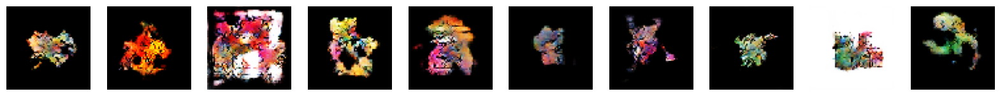

100/100 [==============================] - 86s 856ms/step - c_loss: -4.8012 - c_wass_loss: -5.5000 - c_gp: 0.0699 - g_loss: 16.2772
Epoch 154/200
100/100 [==============================] - ETA: 0s - c_loss: -4.7014 - c_wass_loss: -5.3880 - c_gp: 0.0687 - g_loss: 10.6915
Saved to ./output/generated_img_153.png


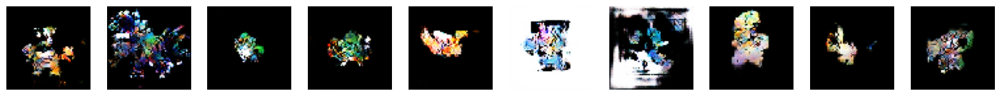

100/100 [==============================] - 86s 856ms/step - c_loss: -4.7014 - c_wass_loss: -5.3880 - c_gp: 0.0687 - g_loss: 10.6915
Epoch 155/200
100/100 [==============================] - ETA: 0s - c_loss: -4.7020 - c_wass_loss: -5.3898 - c_gp: 0.0688 - g_loss: 9.5973
Saved to ./output/generated_img_154.png


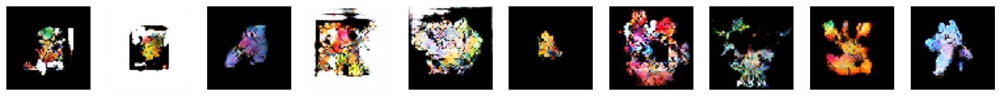

100/100 [==============================] - 86s 863ms/step - c_loss: -4.7020 - c_wass_loss: -5.3898 - c_gp: 0.0688 - g_loss: 9.5973
Epoch 156/200
100/100 [==============================] - ETA: 0s - c_loss: -4.5496 - c_wass_loss: -5.3019 - c_gp: 0.0752 - g_loss: 17.5972
Saved to ./output/generated_img_155.png


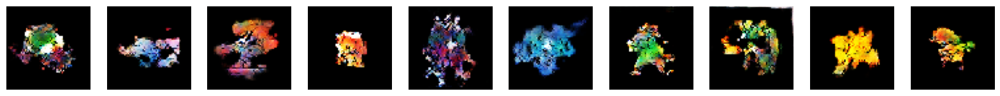

100/100 [==============================] - 85s 855ms/step - c_loss: -4.5496 - c_wass_loss: -5.3019 - c_gp: 0.0752 - g_loss: 17.5972
Epoch 157/200
100/100 [==============================] - ETA: 0s - c_loss: -4.7136 - c_wass_loss: -5.3969 - c_gp: 0.0683 - g_loss: 13.4587
Saved to ./output/generated_img_156.png


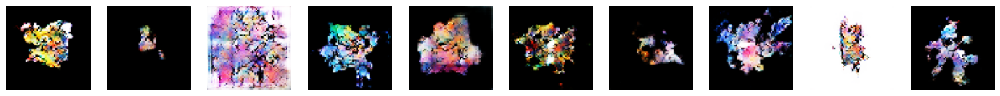

100/100 [==============================] - 86s 863ms/step - c_loss: -4.7136 - c_wass_loss: -5.3969 - c_gp: 0.0683 - g_loss: 13.4587
Epoch 158/200
100/100 [==============================] - ETA: 0s - c_loss: -4.5521 - c_wass_loss: -5.2307 - c_gp: 0.0679 - g_loss: 12.1528
Saved to ./output/generated_img_157.png


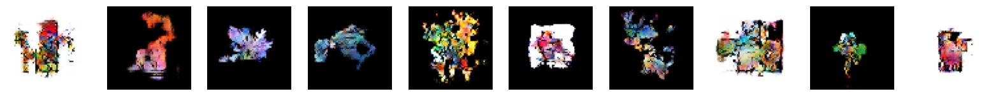

100/100 [==============================] - 85s 853ms/step - c_loss: -4.5521 - c_wass_loss: -5.2307 - c_gp: 0.0679 - g_loss: 12.1528
Epoch 159/200
100/100 [==============================] - ETA: 0s - c_loss: -4.5328 - c_wass_loss: -5.1842 - c_gp: 0.0651 - g_loss: 8.1804
Saved to ./output/generated_img_158.png


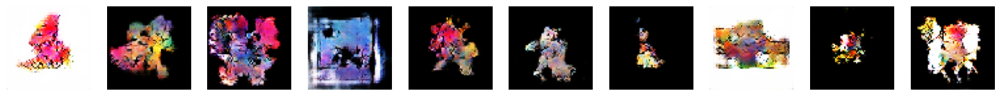

100/100 [==============================] - 86s 865ms/step - c_loss: -4.5328 - c_wass_loss: -5.1842 - c_gp: 0.0651 - g_loss: 8.1804
Epoch 160/200
100/100 [==============================] - ETA: 0s - c_loss: -4.9138 - c_wass_loss: -5.5977 - c_gp: 0.0684 - g_loss: 9.9855
Saved to ./output/generated_img_159.png


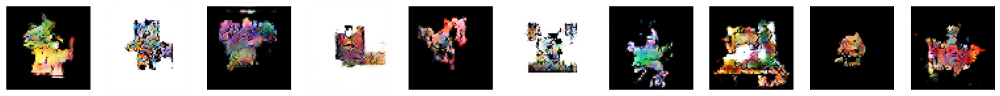

100/100 [==============================] - 86s 856ms/step - c_loss: -4.9138 - c_wass_loss: -5.5977 - c_gp: 0.0684 - g_loss: 9.9855
Epoch 161/200
100/100 [==============================] - ETA: 0s - c_loss: -4.6755 - c_wass_loss: -5.3579 - c_gp: 0.0682 - g_loss: 20.0056
Saved to ./output/generated_img_160.png


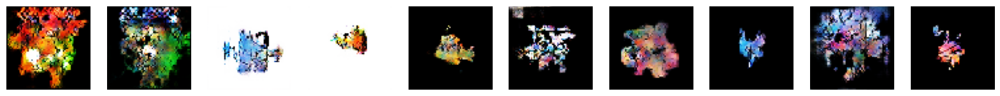

100/100 [==============================] - 88s 877ms/step - c_loss: -4.6755 - c_wass_loss: -5.3579 - c_gp: 0.0682 - g_loss: 20.0056
Epoch 162/200
100/100 [==============================] - ETA: 0s - c_loss: -4.9442 - c_wass_loss: -5.6328 - c_gp: 0.0689 - g_loss: 22.5775
Saved to ./output/generated_img_161.png


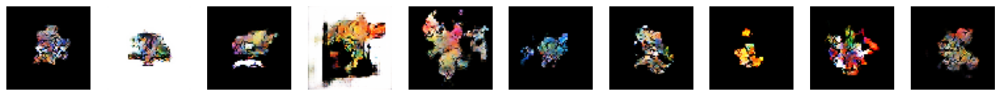

100/100 [==============================] - 86s 855ms/step - c_loss: -4.9442 - c_wass_loss: -5.6328 - c_gp: 0.0689 - g_loss: 22.5775
Epoch 163/200
100/100 [==============================] - ETA: 0s - c_loss: -4.6266 - c_wass_loss: -5.2810 - c_gp: 0.0654 - g_loss: 14.3971
Saved to ./output/generated_img_162.png


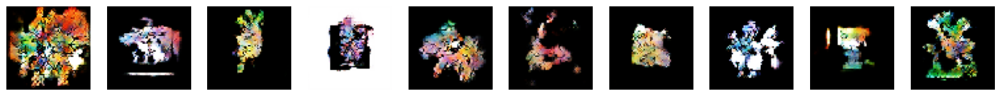

100/100 [==============================] - 85s 855ms/step - c_loss: -4.6266 - c_wass_loss: -5.2810 - c_gp: 0.0654 - g_loss: 14.3971
Epoch 164/200
100/100 [==============================] - ETA: 0s - c_loss: -4.4515 - c_wass_loss: -5.1002 - c_gp: 0.0649 - g_loss: 14.0806
Saved to ./output/generated_img_163.png


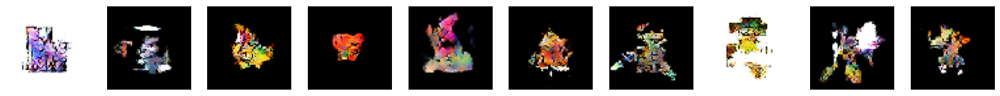

100/100 [==============================] - 86s 860ms/step - c_loss: -4.4515 - c_wass_loss: -5.1002 - c_gp: 0.0649 - g_loss: 14.0806
Epoch 165/200
100/100 [==============================] - ETA: 0s - c_loss: -4.9720 - c_wass_loss: -5.6527 - c_gp: 0.0681 - g_loss: 21.4954
Saved to ./output/generated_img_164.png


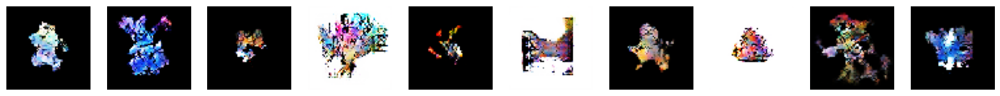

100/100 [==============================] - 85s 854ms/step - c_loss: -4.9720 - c_wass_loss: -5.6527 - c_gp: 0.0681 - g_loss: 21.4954
Epoch 166/200
100/100 [==============================] - ETA: 0s - c_loss: -4.4566 - c_wass_loss: -5.1079 - c_gp: 0.0651 - g_loss: 17.3557
Saved to ./output/generated_img_165.png


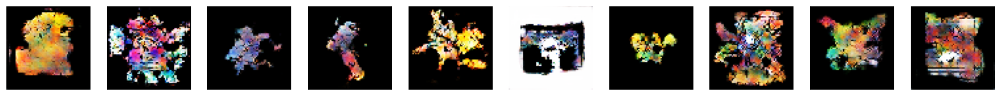

100/100 [==============================] - 86s 863ms/step - c_loss: -4.4566 - c_wass_loss: -5.1079 - c_gp: 0.0651 - g_loss: 17.3557
Epoch 167/200
100/100 [==============================] - ETA: 0s - c_loss: -4.6943 - c_wass_loss: -5.3658 - c_gp: 0.0671 - g_loss: 14.4371
Saved to ./output/generated_img_166.png


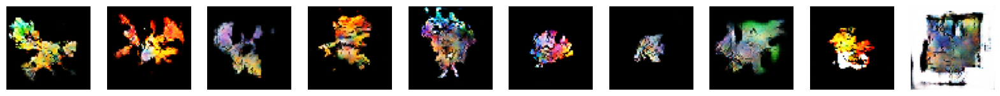

100/100 [==============================] - 86s 859ms/step - c_loss: -4.6943 - c_wass_loss: -5.3658 - c_gp: 0.0671 - g_loss: 14.4371
Epoch 168/200
100/100 [==============================] - ETA: 0s - c_loss: -4.7547 - c_wass_loss: -5.3953 - c_gp: 0.0641 - g_loss: 11.3758
Saved to ./output/generated_img_167.png


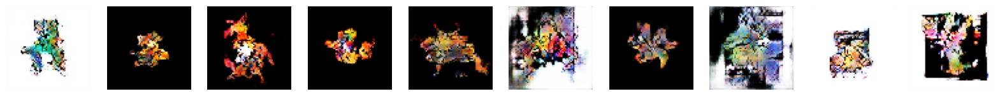

100/100 [==============================] - 86s 862ms/step - c_loss: -4.7547 - c_wass_loss: -5.3953 - c_gp: 0.0641 - g_loss: 11.3758
Epoch 169/200
100/100 [==============================] - ETA: 0s - c_loss: -4.9405 - c_wass_loss: -5.6651 - c_gp: 0.0725 - g_loss: 12.7350
Saved to ./output/generated_img_168.png


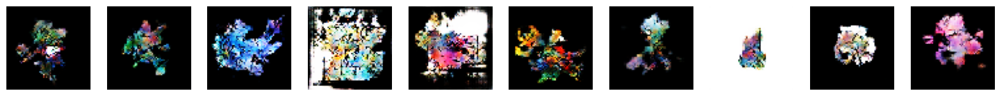

100/100 [==============================] - 85s 855ms/step - c_loss: -4.9405 - c_wass_loss: -5.6651 - c_gp: 0.0725 - g_loss: 12.7350
Epoch 170/200
100/100 [==============================] - ETA: 0s - c_loss: -4.6637 - c_wass_loss: -5.3305 - c_gp: 0.0667 - g_loss: 16.2072
Saved to ./output/generated_img_169.png


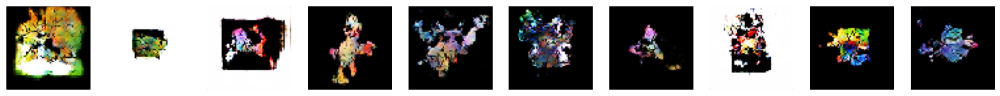

100/100 [==============================] - 87s 872ms/step - c_loss: -4.6637 - c_wass_loss: -5.3305 - c_gp: 0.0667 - g_loss: 16.2072
Epoch 171/200
100/100 [==============================] - ETA: 0s - c_loss: -4.6783 - c_wass_loss: -5.3764 - c_gp: 0.0698 - g_loss: 13.7773
Saved to ./output/generated_img_170.png


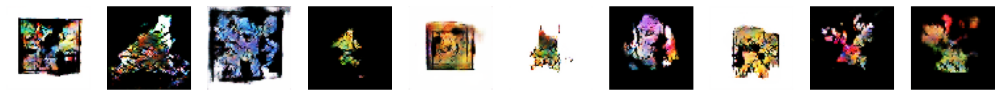

100/100 [==============================] - 86s 856ms/step - c_loss: -4.6783 - c_wass_loss: -5.3764 - c_gp: 0.0698 - g_loss: 13.7773
Epoch 172/200
100/100 [==============================] - ETA: 0s - c_loss: -4.6710 - c_wass_loss: -5.3293 - c_gp: 0.0658 - g_loss: 21.1593
Saved to ./output/generated_img_171.png


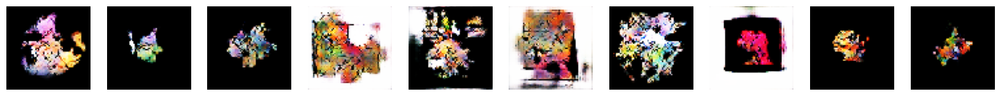

100/100 [==============================] - 85s 852ms/step - c_loss: -4.6710 - c_wass_loss: -5.3293 - c_gp: 0.0658 - g_loss: 21.1593
Epoch 173/200
100/100 [==============================] - ETA: 0s - c_loss: -4.4735 - c_wass_loss: -5.1283 - c_gp: 0.0655 - g_loss: 17.9199
Saved to ./output/generated_img_172.png


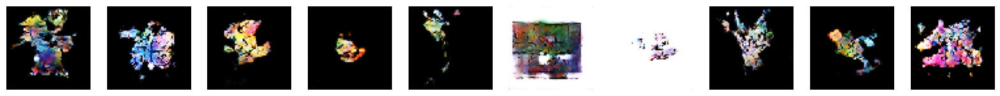

100/100 [==============================] - 87s 866ms/step - c_loss: -4.4735 - c_wass_loss: -5.1283 - c_gp: 0.0655 - g_loss: 17.9199
Epoch 174/200
100/100 [==============================] - ETA: 0s - c_loss: -4.6699 - c_wass_loss: -5.3290 - c_gp: 0.0659 - g_loss: 23.4784
Saved to ./output/generated_img_173.png


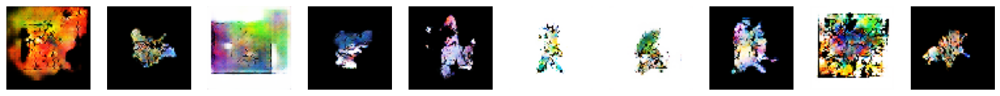

100/100 [==============================] - 85s 854ms/step - c_loss: -4.6699 - c_wass_loss: -5.3290 - c_gp: 0.0659 - g_loss: 23.4784
Epoch 175/200
100/100 [==============================] - ETA: 0s - c_loss: -4.6343 - c_wass_loss: -5.2461 - c_gp: 0.0612 - g_loss: 23.7636
Saved to ./output/generated_img_174.png


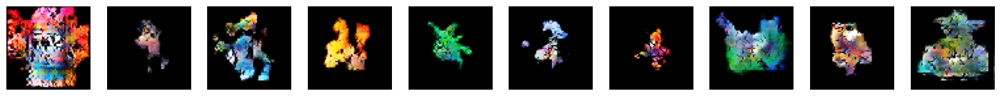

100/100 [==============================] - 86s 863ms/step - c_loss: -4.6343 - c_wass_loss: -5.2461 - c_gp: 0.0612 - g_loss: 23.7636
Epoch 176/200
100/100 [==============================] - ETA: 0s - c_loss: -4.6611 - c_wass_loss: -5.3257 - c_gp: 0.0665 - g_loss: 17.9739
Saved to ./output/generated_img_175.png


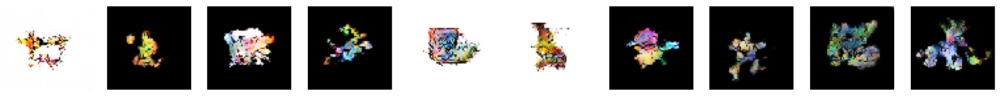

100/100 [==============================] - 86s 855ms/step - c_loss: -4.6611 - c_wass_loss: -5.3257 - c_gp: 0.0665 - g_loss: 17.9739
Epoch 177/200
100/100 [==============================] - ETA: 0s - c_loss: -4.6889 - c_wass_loss: -5.3582 - c_gp: 0.0669 - g_loss: 17.5459
Saved to ./output/generated_img_176.png


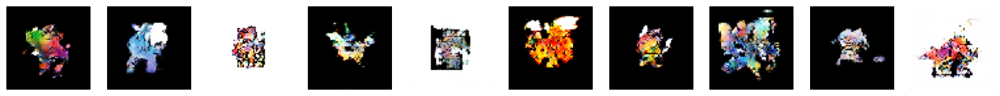

100/100 [==============================] - 86s 862ms/step - c_loss: -4.6889 - c_wass_loss: -5.3582 - c_gp: 0.0669 - g_loss: 17.5459
Epoch 178/200
100/100 [==============================] - ETA: 0s - c_loss: -4.5987 - c_wass_loss: -5.2360 - c_gp: 0.0637 - g_loss: 9.9273
Saved to ./output/generated_img_177.png


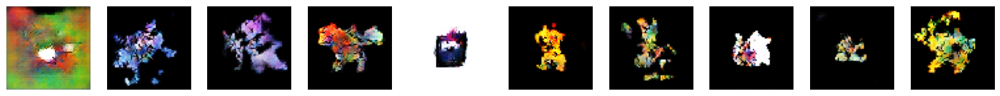

100/100 [==============================] - 85s 854ms/step - c_loss: -4.5987 - c_wass_loss: -5.2360 - c_gp: 0.0637 - g_loss: 9.9273
Epoch 179/200
100/100 [==============================] - ETA: 0s - c_loss: -4.6515 - c_wass_loss: -5.3062 - c_gp: 0.0655 - g_loss: 17.6904
Saved to ./output/generated_img_178.png


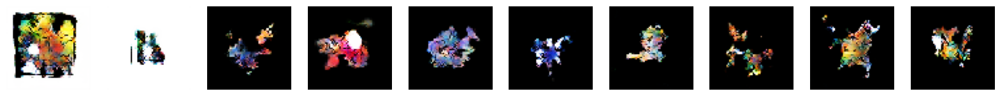

100/100 [==============================] - 86s 864ms/step - c_loss: -4.6515 - c_wass_loss: -5.3062 - c_gp: 0.0655 - g_loss: 17.6904
Epoch 180/200
100/100 [==============================] - ETA: 0s - c_loss: -4.6161 - c_wass_loss: -5.2476 - c_gp: 0.0631 - g_loss: 21.3113
Saved to ./output/generated_img_179.png


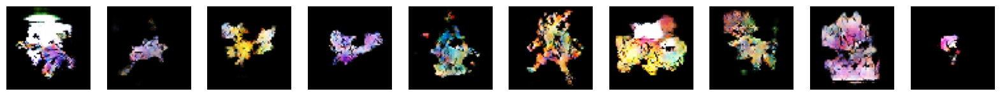

100/100 [==============================] - 86s 856ms/step - c_loss: -4.6161 - c_wass_loss: -5.2476 - c_gp: 0.0631 - g_loss: 21.3113
Epoch 181/200
100/100 [==============================] - ETA: 0s - c_loss: -4.6218 - c_wass_loss: -5.2790 - c_gp: 0.0657 - g_loss: 17.0882
Saved to ./output/generated_img_180.png


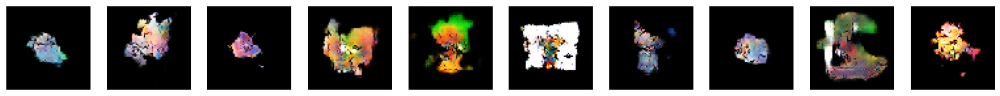

100/100 [==============================] - 86s 860ms/step - c_loss: -4.6218 - c_wass_loss: -5.2790 - c_gp: 0.0657 - g_loss: 17.0882
Epoch 182/200
100/100 [==============================] - ETA: 0s - c_loss: -4.4629 - c_wass_loss: -5.1280 - c_gp: 0.0665 - g_loss: 13.1697
Saved to ./output/generated_img_181.png


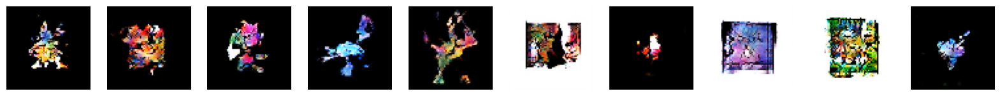

100/100 [==============================] - 86s 862ms/step - c_loss: -4.4629 - c_wass_loss: -5.1280 - c_gp: 0.0665 - g_loss: 13.1697
Epoch 183/200
100/100 [==============================] - ETA: 0s - c_loss: -4.7507 - c_wass_loss: -5.3789 - c_gp: 0.0628 - g_loss: 17.1484
Saved to ./output/generated_img_182.png


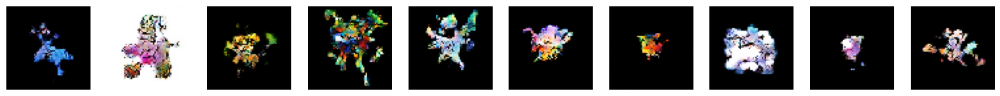

100/100 [==============================] - 85s 854ms/step - c_loss: -4.7507 - c_wass_loss: -5.3789 - c_gp: 0.0628 - g_loss: 17.1484
Epoch 184/200
100/100 [==============================] - ETA: 0s - c_loss: -4.5860 - c_wass_loss: -5.2297 - c_gp: 0.0644 - g_loss: 15.0141
Saved to ./output/generated_img_183.png


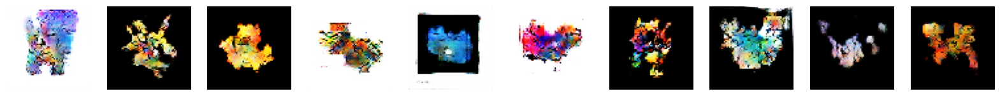

100/100 [==============================] - 86s 861ms/step - c_loss: -4.5860 - c_wass_loss: -5.2297 - c_gp: 0.0644 - g_loss: 15.0141
Epoch 185/200
100/100 [==============================] - ETA: 0s - c_loss: -4.6777 - c_wass_loss: -5.3235 - c_gp: 0.0646 - g_loss: 13.6367
Saved to ./output/generated_img_184.png


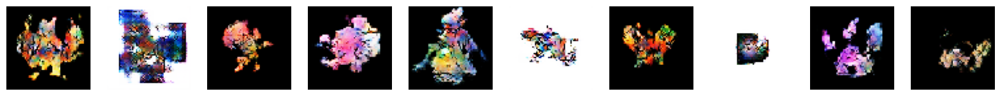

100/100 [==============================] - 85s 854ms/step - c_loss: -4.6777 - c_wass_loss: -5.3235 - c_gp: 0.0646 - g_loss: 13.6367
Epoch 186/200
100/100 [==============================] - ETA: 0s - c_loss: -4.6268 - c_wass_loss: -5.2789 - c_gp: 0.0652 - g_loss: 15.1231
Saved to ./output/generated_img_185.png


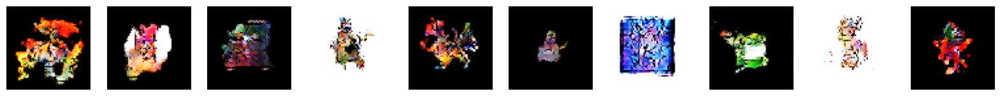

100/100 [==============================] - 86s 864ms/step - c_loss: -4.6268 - c_wass_loss: -5.2789 - c_gp: 0.0652 - g_loss: 15.1231
Epoch 187/200
100/100 [==============================] - ETA: 0s - c_loss: -4.7104 - c_wass_loss: -5.4077 - c_gp: 0.0697 - g_loss: 17.5867
Saved to ./output/generated_img_186.png


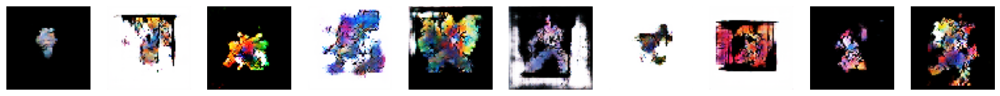

100/100 [==============================] - 86s 856ms/step - c_loss: -4.7104 - c_wass_loss: -5.4077 - c_gp: 0.0697 - g_loss: 17.5867
Epoch 188/200
100/100 [==============================] - ETA: 0s - c_loss: -4.5976 - c_wass_loss: -5.2880 - c_gp: 0.0690 - g_loss: 11.4664
Saved to ./output/generated_img_187.png


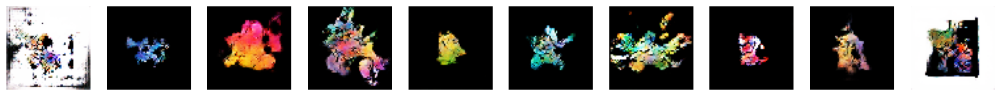

100/100 [==============================] - 86s 862ms/step - c_loss: -4.5976 - c_wass_loss: -5.2880 - c_gp: 0.0690 - g_loss: 11.4664
Epoch 189/200
100/100 [==============================] - ETA: 0s - c_loss: -4.6785 - c_wass_loss: -5.3147 - c_gp: 0.0636 - g_loss: 12.2254
Saved to ./output/generated_img_188.png


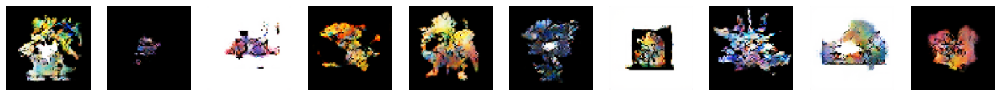

100/100 [==============================] - 86s 855ms/step - c_loss: -4.6785 - c_wass_loss: -5.3147 - c_gp: 0.0636 - g_loss: 12.2254
Epoch 190/200
100/100 [==============================] - ETA: 0s - c_loss: -4.5491 - c_wass_loss: -5.2117 - c_gp: 0.0663 - g_loss: 4.9075
Saved to ./output/generated_img_189.png


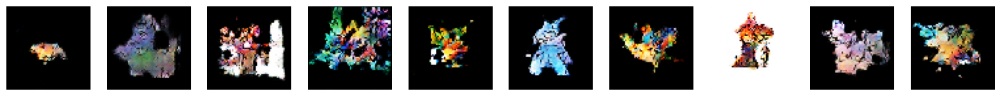

100/100 [==============================] - 86s 865ms/step - c_loss: -4.5491 - c_wass_loss: -5.2117 - c_gp: 0.0663 - g_loss: 4.9075
Epoch 191/200
100/100 [==============================] - ETA: 0s - c_loss: -4.7641 - c_wass_loss: -5.4340 - c_gp: 0.0670 - g_loss: 16.5983
Saved to ./output/generated_img_190.png


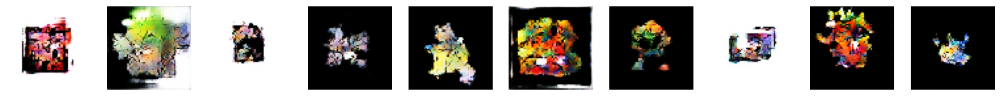

100/100 [==============================] - 86s 857ms/step - c_loss: -4.7641 - c_wass_loss: -5.4340 - c_gp: 0.0670 - g_loss: 16.5983
Epoch 192/200
100/100 [==============================] - ETA: 0s - c_loss: -4.5057 - c_wass_loss: -5.1701 - c_gp: 0.0664 - g_loss: 15.0111
Saved to ./output/generated_img_191.png


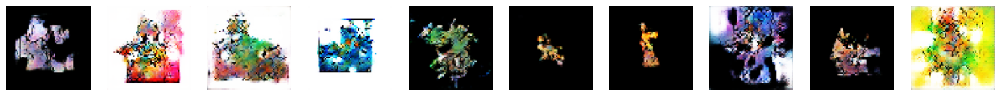

100/100 [==============================] - 86s 856ms/step - c_loss: -4.5057 - c_wass_loss: -5.1701 - c_gp: 0.0664 - g_loss: 15.0111
Epoch 193/200
100/100 [==============================] - ETA: 0s - c_loss: -4.6950 - c_wass_loss: -5.3605 - c_gp: 0.0666 - g_loss: 19.9186
Saved to ./output/generated_img_192.png


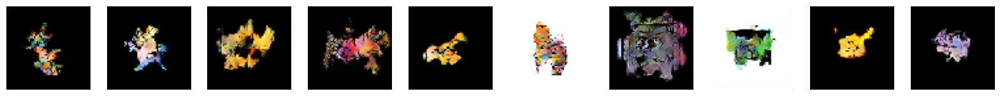

100/100 [==============================] - 86s 860ms/step - c_loss: -4.6950 - c_wass_loss: -5.3605 - c_gp: 0.0666 - g_loss: 19.9186
Epoch 194/200
100/100 [==============================] - ETA: 0s - c_loss: -4.6039 - c_wass_loss: -5.2631 - c_gp: 0.0659 - g_loss: 11.5049
Saved to ./output/generated_img_193.png


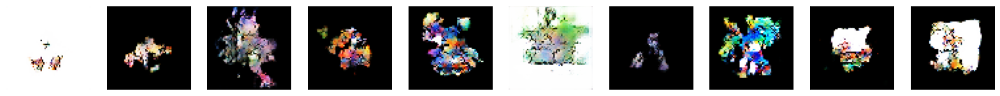

100/100 [==============================] - 86s 856ms/step - c_loss: -4.6039 - c_wass_loss: -5.2631 - c_gp: 0.0659 - g_loss: 11.5049
Epoch 195/200
100/100 [==============================] - ETA: 0s - c_loss: -4.5624 - c_wass_loss: -5.2065 - c_gp: 0.0644 - g_loss: 14.3350
Saved to ./output/generated_img_194.png


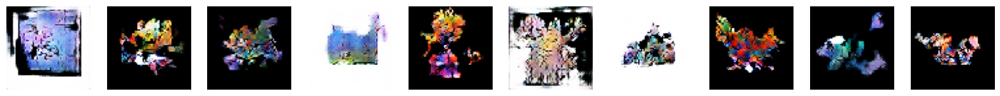

100/100 [==============================] - 86s 859ms/step - c_loss: -4.5624 - c_wass_loss: -5.2065 - c_gp: 0.0644 - g_loss: 14.3350
Epoch 196/200
100/100 [==============================] - ETA: 0s - c_loss: -4.6833 - c_wass_loss: -5.3760 - c_gp: 0.0693 - g_loss: 18.4512
Saved to ./output/generated_img_195.png


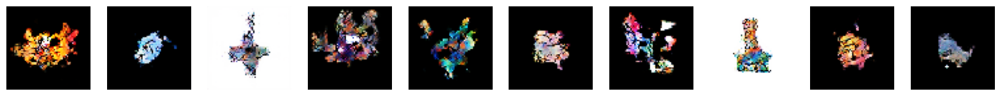

100/100 [==============================] - 85s 854ms/step - c_loss: -4.6833 - c_wass_loss: -5.3760 - c_gp: 0.0693 - g_loss: 18.4512
Epoch 197/200
100/100 [==============================] - ETA: 0s - c_loss: -4.6292 - c_wass_loss: -5.2903 - c_gp: 0.0661 - g_loss: 15.0571
Saved to ./output/generated_img_196.png


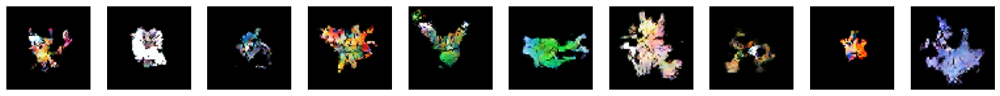

100/100 [==============================] - 86s 861ms/step - c_loss: -4.6292 - c_wass_loss: -5.2903 - c_gp: 0.0661 - g_loss: 15.0571
Epoch 198/200
100/100 [==============================] - ETA: 0s - c_loss: -4.5261 - c_wass_loss: -5.1766 - c_gp: 0.0651 - g_loss: 17.5472
Saved to ./output/generated_img_197.png


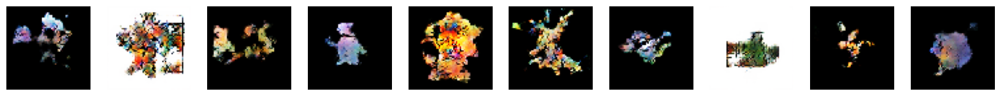

100/100 [==============================] - 85s 855ms/step - c_loss: -4.5261 - c_wass_loss: -5.1766 - c_gp: 0.0651 - g_loss: 17.5472
Epoch 199/200
100/100 [==============================] - ETA: 0s - c_loss: -4.5029 - c_wass_loss: -5.1574 - c_gp: 0.0654 - g_loss: 13.3838
Saved to ./output/generated_img_198.png


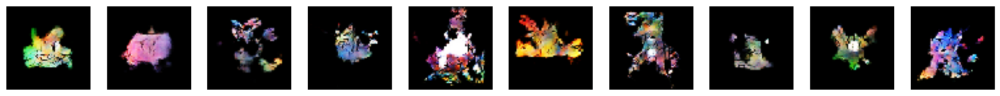

100/100 [==============================] - 87s 873ms/step - c_loss: -4.5029 - c_wass_loss: -5.1574 - c_gp: 0.0654 - g_loss: 13.3838
Epoch 200/200
100/100 [==============================] - ETA: 0s - c_loss: -4.5257 - c_wass_loss: -5.1891 - c_gp: 0.0663 - g_loss: 24.0954
Saved to ./output/generated_img_199.png


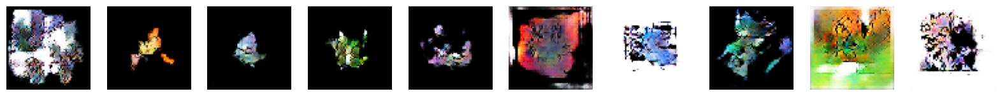

100/100 [==============================] - 86s 856ms/step - c_loss: -4.5257 - c_wass_loss: -5.1891 - c_gp: 0.0663 - g_loss: 24.0954


In [23]:
wgangp.fit(
    train,
    epochs=EPOCHS,
    steps_per_epoch=STEPS_PER_EPOCH,
    callbacks=[
        model_checkpoint_callback,
        tensorboard_callback,
        ImageGenerator(num_img=10, latent_dim=Z_DIM),
    ],
)

In [24]:
# Save the final models
generator.save("./models/generator")
critic.save("./models/critic")

INFO:tensorflow:Assets written to: ./models/generator/assets


INFO:tensorflow:Assets written to: ./models/generator/assets


INFO:tensorflow:Assets written to: ./models/critic/assets


INFO:tensorflow:Assets written to: ./models/critic/assets


## Generate images

1/1 [==============================] - 0s 277ms/step


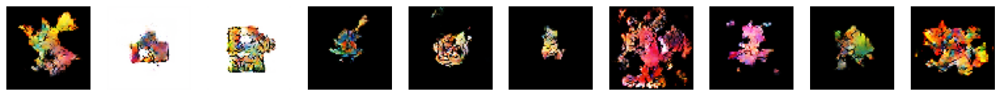

In [25]:
z_sample = np.random.normal(size=(10, Z_DIM))
imgs = wgangp.generator.predict(z_sample)
display(imgs, cmap=None)

1/1 [==============================] - 0s 28ms/step


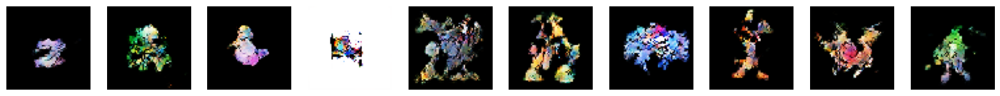

In [26]:
z_sample = np.random.normal(size=(10, Z_DIM))
imgs = wgangp.generator.predict(z_sample)
display(imgs, cmap=None)

1/1 [==============================] - 0s 27ms/step


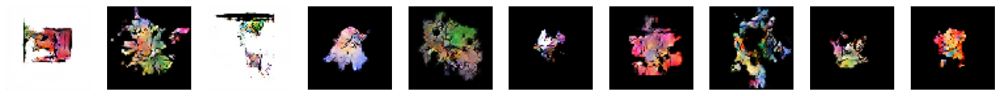

In [27]:
z_sample = np.random.normal(size=(10, Z_DIM))
imgs = wgangp.generator.predict(z_sample)
display(imgs, cmap=None)